In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import seaborn as sns
import matplotlib.font_manager as fm
import matplotlib as mpl
from collections import defaultdict
import ast

In [2]:
plt.rcParams['font.family'] = 'AppleGothic'
mpl.rcParams['axes.unicode_minus'] = False

In [3]:
def safe_literal_eval(val):
    """
    주어진 값이 문자열로 되어 있고 '['로 시작하면 ast.literal_eval을 시도하고,
    그렇지 않으면 그대로 반환하는 함수.
    """
    if isinstance(val, str) and val.strip().startswith('['):
        try:
            return ast.literal_eval(val)
        except Exception as e:
            print("literal_eval 오류:", e, "값:", val)
            return None
    # 문자열이 아니면 그대로 반환 (예: 이미 리스트 또는 numpy 배열인 경우)
    return val

In [4]:
# 1. 병합된 데이터 로드 (CSV 파일)
tsf_file_path = "./dataset/final_dataset/M4_Yearly_Merged.csv"  # CSV 파일 경로
df_q = pd.read_csv(tsf_file_path)

# 2. 병합된 데이터에서 'category' 컬럼을 기준으로 도메인별 그룹화
domain_time_series = defaultdict(dict)
for idx, row in df_q.iterrows():
    category = row['category']  # 도메인 정보 (예: Macro, Finance 등)
    ts_id = row['series_name']
    # series_value 컬럼은 문자열 형태의 리스트이므로 안전하게 변환
    values = safe_literal_eval(row['series_value'])
    if values is None:
        continue
    domain_time_series[category][ts_id] = (row['start_timestamp'], values)

In [5]:
domain_time_series

defaultdict(dict,
            {'Macro': {'Y1': ('1979-01-01 12:00:00',
               [5172.1,
                5133.5,
                5186.9,
                5084.6,
                5182.0,
                5414.3,
                5576.2,
                5752.9,
                5955.2,
                6087.8,
                6238.9,
                6317.2,
                6262.7,
                6361.0,
                6427.4,
                6654.9,
                6835.4,
                6925.5,
                7073.5,
                7144.0,
                7230.6,
                7349.6,
                7339.2,
                7250.8,
                7294.6,
                7393.9,
                7560.9,
                7651.4,
                7587.3,
                7530.5,
                7261.1,
                7290.2,
                7392.6,
                7527.6,
                7594.8,
                7720.7,
                7823.2]),
              'Y2': ('1979-01-01 12:00:

### 결측값 확인

In [6]:
def check_missing_values(domain_time_series):
    """
    시계열 데이터에서 결측값(NaN)을 확인합니다.
    """
    missing_stats = {
        'total_series': 0,
        'series_with_missing': 0,
        'total_values': 0,
        'total_missing': 0,
        'series_details': []
    }
    
    # 먼저 모든 시계열의 총 수를 계산
    total_series = 0
    for domain, series_dict in domain_time_series.items():
        total_series += len(series_dict)
    
    missing_stats['total_series'] = total_series
    
    # 각 도메인과 시리즈를 반복
    for domain, series_dict in domain_time_series.items():
        for ts_id, (start_time, values) in series_dict.items():
            total = len(values)
            missing = sum(np.isnan(v) for v in values)
            missing_ratio = missing / total if total > 0 else 0
            
            missing_stats['total_values'] += total
            missing_stats['total_missing'] += missing
            
            if missing > 0:
                missing_stats['series_with_missing'] += 1
                missing_stats['series_details'].append({
                    'domain': domain,
                    'ts_id': ts_id,
                    'total_values': total,
                    'missing_values': missing,
                    'missing_ratio': missing_ratio
                })
    
    # 전체 결측치 비율 계산
    if missing_stats['total_values'] > 0:
        missing_stats['overall_missing_ratio'] = missing_stats['total_missing'] / missing_stats['total_values']
    else:
        missing_stats['overall_missing_ratio'] = 0
        
    return missing_stats

# 결측값 확인
missing_stats = check_missing_values(domain_time_series)
print("\n===== 결측값 통계 =====")
print(f"전체 시계열 수: {missing_stats['total_series']}")
print(f"결측값이 있는 시계열 수: {missing_stats['series_with_missing']}")
print(f"전체 데이터 포인트 수: {missing_stats['total_values']}")
print(f"전체 결측값 수: {missing_stats['total_missing']}")
print(f"전체 결측치 비율: {missing_stats['overall_missing_ratio']:.6f} ({missing_stats['overall_missing_ratio']*100:.4f}%)")

# 결측값이 있는 경우 세부 정보 표시
if missing_stats['series_with_missing'] > 0:
    print("\n결측값이 있는 시계열 세부 정보:")
    for detail in missing_stats['series_details']:
        print(f" {detail['domain']}-{detail['ts_id']}: {detail['missing_values']} 결측값 / {detail['total_values']} 전체 ({detail['missing_ratio']*100:.2f}%)")


===== 결측값 통계 =====
전체 시계열 수: 23000
결측값이 있는 시계열 수: 0
전체 데이터 포인트 수: 858458
전체 결측값 수: 0
전체 결측치 비율: 0.000000 (0.0000%)


### 해당 frequency의 시계열 길이 분포 확인

시계열 총 개수: 23000
최소 길이: 19
최대 길이: 841
평균 길이: 37.32

길이 분포:
 길이 19: 235개 시계열 (1.02%)
 길이 20: 31개 시계열 (0.13%)
 길이 21: 2657개 시계열 (11.55%)
 길이 22: 642개 시계열 (2.79%)
 길이 23: 374개 시계열 (1.63%)
 길이 24: 617개 시계열 (2.68%)
 길이 25: 620개 시계열 (2.70%)
 길이 26: 1861개 시계열 (8.09%)
 길이 27: 886개 시계열 (3.85%)
 길이 28: 459개 시계열 (2.00%)
 길이 29: 376개 시계열 (1.63%)
 길이 30: 622개 시계열 (2.70%)
 길이 31: 173개 시계열 (0.75%)
 길이 32: 548개 시계열 (2.38%)
 길이 33: 190개 시계열 (0.83%)
 길이 34: 518개 시계열 (2.25%)
 길이 35: 2939개 시계열 (12.78%)
 길이 36: 192개 시계열 (0.83%)
 길이 37: 154개 시계열 (0.67%)
 길이 38: 182개 시계열 (0.79%)
 길이 39: 157개 시계열 (0.68%)
 길이 40: 622개 시계열 (2.70%)
 길이 41: 331개 시계열 (1.44%)
 길이 42: 99개 시계열 (0.43%)
 길이 43: 204개 시계열 (0.89%)
 길이 44: 82개 시계열 (0.36%)
 길이 45: 294개 시계열 (1.28%)
 길이 46: 2959개 시계열 (12.87%)
 길이 47: 484개 시계열 (2.10%)
 길이 48: 262개 시계열 (1.14%)
 길이 49: 50개 시계열 (0.22%)
 길이 50: 65개 시계열 (0.28%)
 길이 51: 229개 시계열 (1.00%)
 길이 52: 86개 시계열 (0.37%)
 길이 53: 84개 시계열 (0.37%)
 길이 54: 166개 시계열 (0.72%)
 길이 55: 776개 시계열 (3.37%)
 길이 56: 623개 시계열 

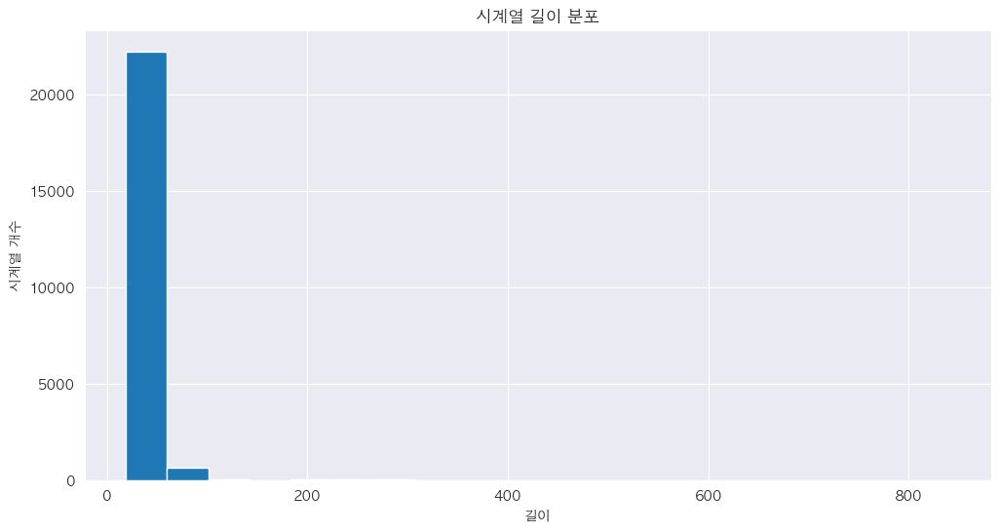

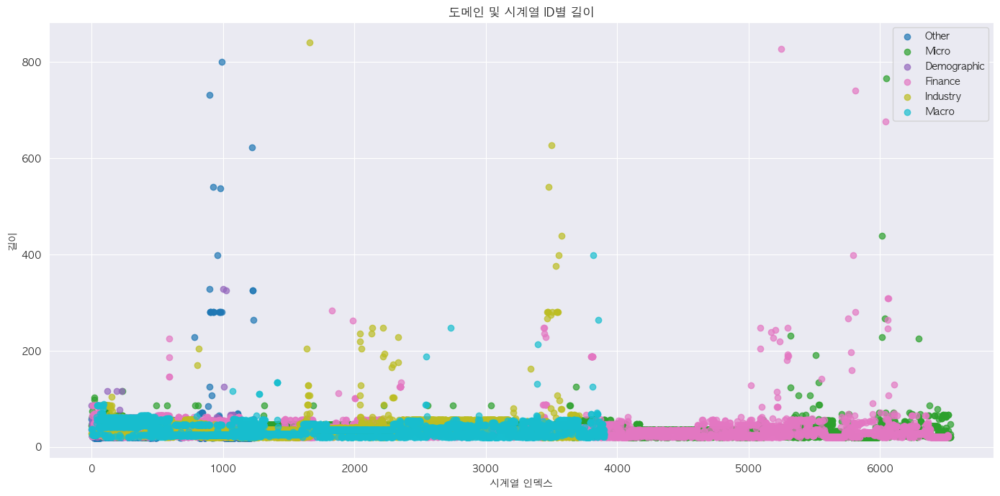

/var/folders/44/rqx09tpj2n91xh4153257d340000gn/T/ipykernel_93830/862153481.py:119: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(domain_data, labels=domain_names)


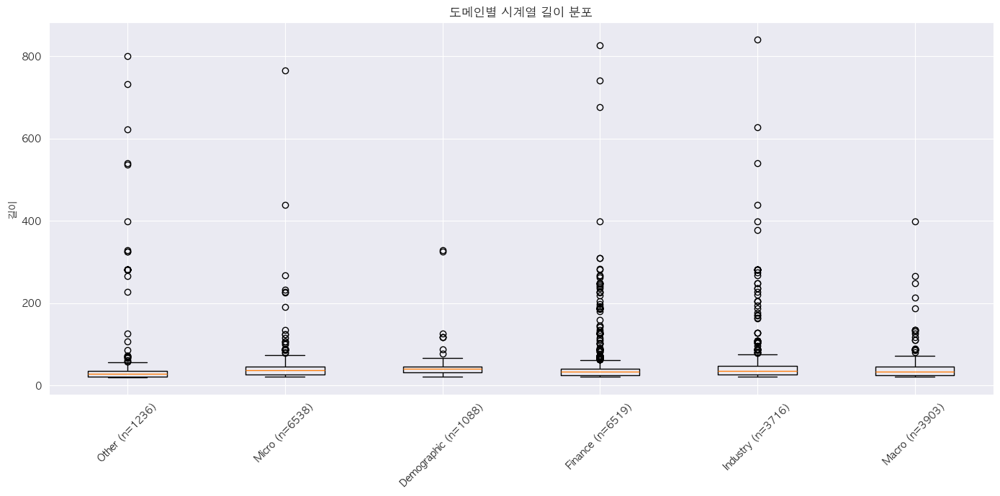

In [7]:
def check_time_series_lengths(domain_time_series):
    """
    시계열 데이터의 길이 분포를 확인하고 요약합니다.
    """
    # 각 시계열의 길이 저장
    lengths = {}
    total_series = 0
    
    # 도메인과 시계열 순회
    for domain, series_dict in domain_time_series.items():
        for ts_id, (start_time, values) in series_dict.items():
            key = f"{domain}-{ts_id}"  # 도메인과 시계열 ID를 합쳐서 고유 키 생성
            lengths[key] = len(values)
            total_series += 1
    
    # 길이 분포 요약
    length_counts = {}
    for length in set(lengths.values()):
        length_counts[length] = list(lengths.values()).count(length)
    
    # 정렬된 길이 분포
    sorted_length_counts = dict(sorted(length_counts.items()))
    
    # 요약 통계
    min_length = min(lengths.values()) if lengths else 0
    max_length = max(lengths.values()) if lengths else 0
    avg_length = sum(lengths.values()) / len(lengths) if lengths else 0
    
    print(f"시계열 총 개수: {len(lengths)}")
    print(f"최소 길이: {min_length}")
    print(f"최대 길이: {max_length}")
    print(f"평균 길이: {avg_length:.2f}")
    
    print("\n길이 분포:")
    for length, count in sorted_length_counts.items():
        print(f" 길이 {length}: {count}개 시계열 ({count/len(lengths)*100:.2f}%)")
    
    # 가장 짧은 시계열과 가장 긴 시계열 찾기
    if lengths:
        shortest_ts = min(lengths, key=lengths.get)
        longest_ts = max(lengths, key=lengths.get)
        print(f"\n가장 짧은 시계열: {shortest_ts} (길이: {lengths[shortest_ts]})")
        print(f"가장 긴 시계열: {longest_ts} (길이: {lengths[longest_ts]})")
    
    # 시작 시간 분포 확인
    start_times = {}
    for domain, series_dict in domain_time_series.items():
        for ts_id, (start_time, _) in series_dict.items():
            if isinstance(start_time, str):
                start_time_str = start_time
            else:
                # datetime 객체라면 문자열로 변환
                try:
                    start_time_str = start_time.strftime('%Y-%m-%d')
                except:
                    start_time_str = str(start_time)
                    
            if start_time_str not in start_times:
                start_times[start_time_str] = 0
            start_times[start_time_str] += 1
    
    print("\n시작 시간 분포:")
    for start_time, count in sorted(start_times.items()):
        print(f" {start_time}: {count}개 시계열")
    
    return lengths

# 함수 실행
lengths = check_time_series_lengths(domain_time_series)

# 시각화
import matplotlib.pyplot as plt

# 시계열 길이 분포 히스토그램
plt.figure(figsize=(12, 6))
plt.hist(list(lengths.values()), bins=20)
plt.title('시계열 길이 분포')
plt.xlabel('길이')
plt.ylabel('시계열 개수')
plt.grid(True)
plt.show()

# 수정된 산점도 - 도메인별로 색상 구분
plt.figure(figsize=(14, 7))

# 도메인 목록 추출 (키에서 하이픈 이전 부분)
domains = list(set([key.split('-')[0] for key in lengths.keys()]))
domain_colors = plt.cm.tab10(np.linspace(0, 1, len(domains)))

# 도메인별로 다른 색상 사용
for i, domain in enumerate(domains):
    domain_keys = [k for k in lengths.keys() if k.startswith(domain+'-')]
    domain_values = [lengths[k] for k in domain_keys]
    
    # 시리즈 ID 부분만 추출 (하이픈 이후 부분)
    series_ids = [k.split('-')[1] for k in domain_keys]
    
    plt.scatter(range(len(domain_keys)), domain_values, 
                color=domain_colors[i], alpha=0.7, label=domain)

plt.title('도메인 및 시계열 ID별 길이')
plt.xlabel('시계열 인덱스')
plt.ylabel('길이')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# 도메인별 길이 박스플롯
plt.figure(figsize=(14, 7))
domain_data = []
domain_names = []

for domain in domains:
    domain_keys = [k for k in lengths.keys() if k.startswith(domain+'-')]
    domain_data.append([lengths[k] for k in domain_keys])
    domain_names.append(f"{domain} (n={len(domain_keys)})")

plt.boxplot(domain_data, labels=domain_names)
plt.title('도메인별 시계열 길이 분포')
plt.ylabel('길이')
plt.grid(True, axis='y')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### 해당 frequency의 시계열의 기본 통계량 계산

전체 시계열 통계량 요약:
             length          mean        median           std           min  \
count  23000.000000  23000.000000  23000.000000  23000.000000  23000.000000   
mean      37.324261   4075.951961   3766.906111   1720.085468   1809.279779   
std       24.523966   2640.551034   2585.779378   1620.496810   1845.122997   
min       19.000000   1000.059084     96.900000     22.385112     22.000000   
25%       26.000000   1788.951756   1608.037500    626.735683    450.000000   
50%       35.000000   3282.392402   2934.875250   1192.212116   1123.070500   
75%       46.000000   6136.335714   5557.792000   2309.259514   2498.457513   
max      841.000000  69990.000000  66740.500000  42705.935304  10693.000000   

                 max          range            cv  
count   23000.000000   23000.000000  23000.000000  
mean     7694.248368    5884.968589      0.440780  
std      5825.979317    5661.166207      0.273982  
min      1056.300000      98.164176      0.020770  
25%      3371

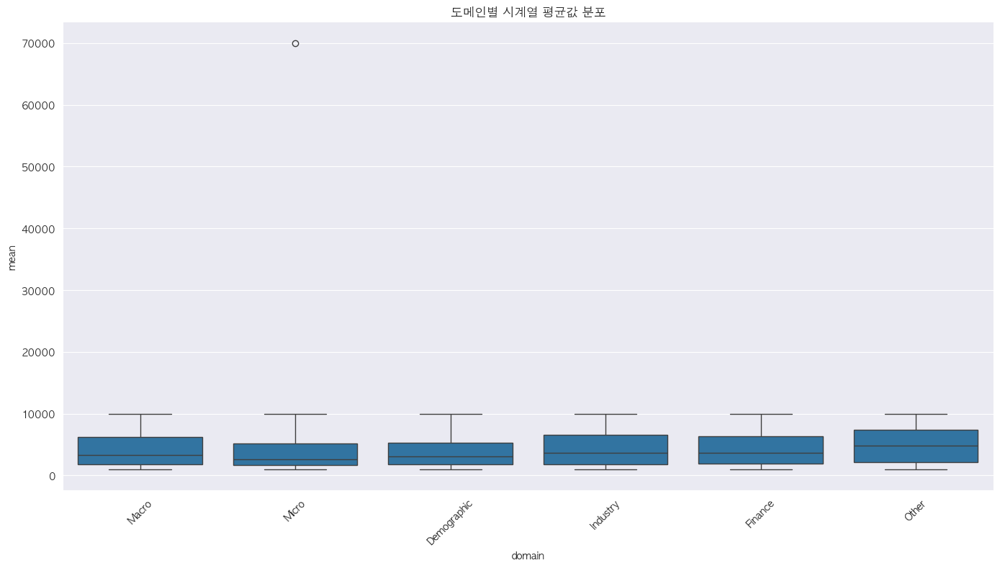

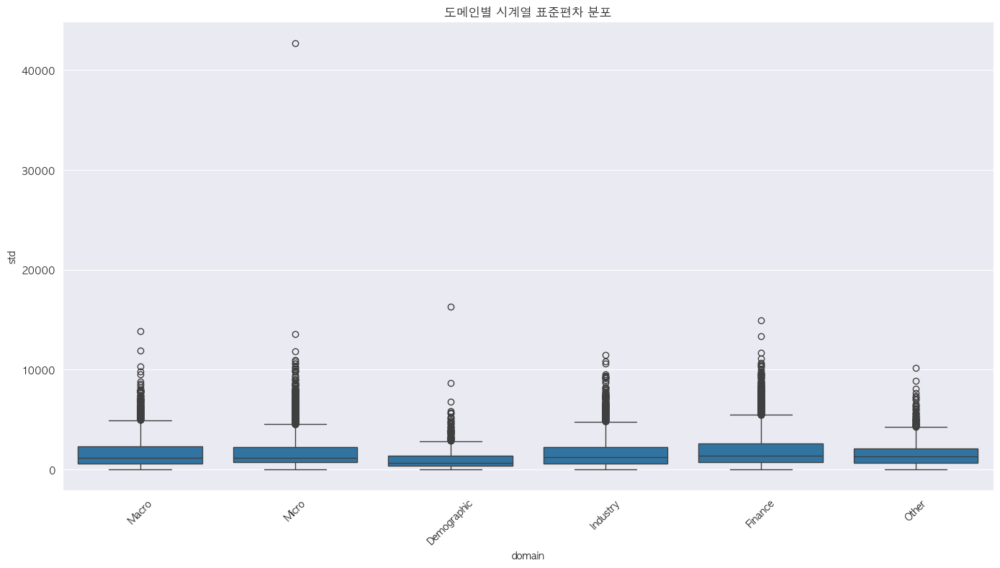

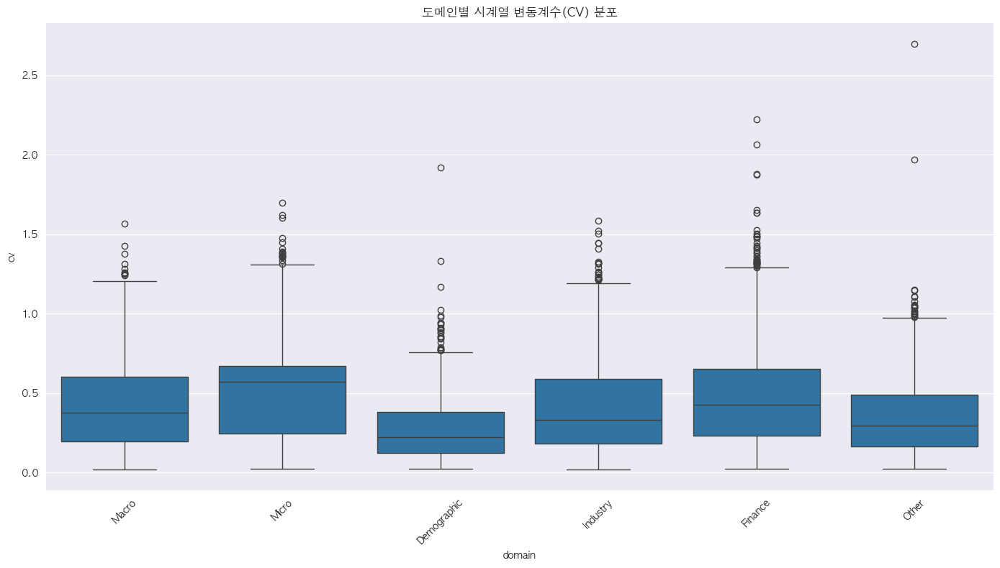

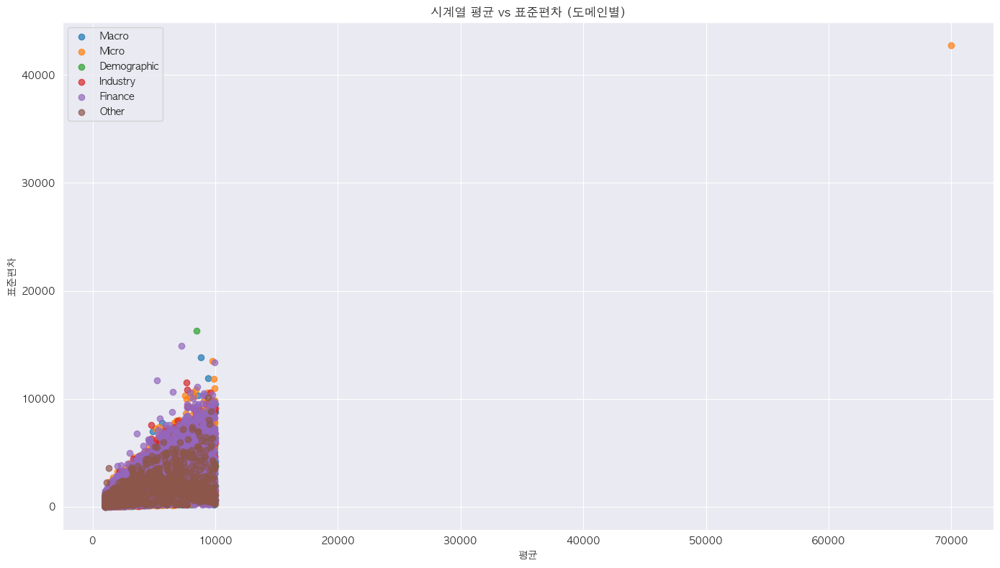


도메인별 통계량 요약 테이블:
            length                    mean                             \
             count       mean         mean          min           max   
domain                                                                  
Demographic   1088  40.864890  3813.152138  1004.183915   9986.925000   
Finance       6519  36.033901  4249.396749  1000.059084   9986.345599   
Industry      3716  39.308127  4307.521983  1000.126000   9997.600000   
Macro         3903  35.800922  4125.361787  1000.370370   9994.000000   
Micro         6538  37.836494  3630.598123  1000.103574  69990.000000   
Other         1236  37.149676  4896.018533  1000.691291   9978.878505   

                  median                                std             \
                    mean         min       max         mean        min   
domain                                                                   
Demographic  3688.790981  361.868400  11290.50  1056.758135  25.068024   
Finance      3898.026868   9

In [8]:
def calculate_basic_statistics(domain_time_series):
    """
    각 시계열의 기본 통계량을 계산합니다.
    """
    stats = []
    
    # 각 도메인과 시계열 반복
    for domain, series_dict in domain_time_series.items():
        for ts_id, (start_time, values) in series_dict.items():
            # NaN 값 제외한 유효한 값들만 사용
            values_clean = np.array([v for v in values if not np.isnan(v)])
            
            if len(values_clean) > 0:
                # 기본 통계량 계산
                stat = {
                    'domain': domain,
                    'ts_id': ts_id,
                    'length': len(values),
                    'mean': np.mean(values_clean),
                    'median': np.median(values_clean),
                    'std': np.std(values_clean),
                    'min': np.min(values_clean),
                    'max': np.max(values_clean),
                    'range': np.max(values_clean) - np.min(values_clean),
                    'cv': np.std(values_clean) / np.mean(values_clean) if np.mean(values_clean) != 0 else np.nan
                }
                stats.append(stat)
    
    # DataFrame으로 변환
    stats_df = pd.DataFrame(stats)
    return stats_df

# 기본 통계량 계산 및 확인
statistics_df = calculate_basic_statistics(domain_time_series)

# 전체 통계량 요약
print("전체 시계열 통계량 요약:")
print(statistics_df.describe())

# 도메인별 통계량 요약
print("\n도메인별 통계량 요약:")
for domain in statistics_df['domain'].unique():
    domain_stats = statistics_df[statistics_df['domain'] == domain]
    print(f"\n== {domain} 도메인 통계량 (총 {len(domain_stats)}개 시계열) ==")
    print(domain_stats.describe())
    
# 도메인별 통계량 시각화
import matplotlib.pyplot as plt
import seaborn as sns

# 도메인별 평균값 비교
plt.figure(figsize=(14, 8))
sns.boxplot(x='domain', y='mean', data=statistics_df)
plt.title('도메인별 시계열 평균값 분포')
plt.xticks(rotation=45)
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()

# 도메인별 표준편차 비교
plt.figure(figsize=(14, 8))
sns.boxplot(x='domain', y='std', data=statistics_df)
plt.title('도메인별 시계열 표준편차 분포')
plt.xticks(rotation=45)
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()

# 도메인별 변동계수(CV) 비교
plt.figure(figsize=(14, 8))
sns.boxplot(x='domain', y='cv', data=statistics_df)
plt.title('도메인별 시계열 변동계수(CV) 분포')
plt.xticks(rotation=45)
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()

# 평균 vs 표준편차 산점도 (도메인별 색상)
plt.figure(figsize=(14, 8))
domains = statistics_df['domain'].unique()
for i, domain in enumerate(domains):
    domain_data = statistics_df[statistics_df['domain'] == domain]
    plt.scatter(domain_data['mean'], domain_data['std'], 
                alpha=0.7, label=domain)

plt.title('시계열 평균 vs 표준편차 (도메인별)')
plt.xlabel('평균')
plt.ylabel('표준편차')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# 도메인별 주요 통계량 요약 테이블
domain_summary = statistics_df.groupby('domain').agg({
    'length': ['count', 'mean'],
    'mean': ['mean', 'min', 'max'],
    'median': ['mean', 'min', 'max'],
    'std': ['mean', 'min', 'max'],
    'range': ['mean', 'min', 'max'],
    'cv': ['mean', 'min', 'max']
})

print("\n도메인별 통계량 요약 테이블:")
print(domain_summary)


=== Macro 도메인 로그 변환 전후 비교 ===

원본 데이터 통계:
              mean        median           std          min            max  \
count  3903.000000   3903.000000   3903.000000  3903.000000    3903.000000   
mean   4125.361787   3842.190765   1660.824562  1907.994656    7566.017794   
std    2590.525437   2541.732640   1539.026760  1802.938230    5598.461754   
min    1000.370370    328.695000     24.789861    32.000000    1074.000000   
25%    1841.642658   1673.975141    559.867689   600.612905    3238.276018   
50%    3362.692308   3078.216817   1154.328947  1293.577550    6048.000000   
75%    6219.828042   5740.763652   2316.761093  2625.045000   10590.927895   
max    9994.000000  11600.000000  13835.792553  9262.008734  103053.707600   

                cv     skewness  
count  3903.000000  3903.000000  
mean      0.416041     0.312356  
std       0.263481     0.612596  
min       0.020770    -6.711108  
25%       0.196996    -0.057404  
50%       0.375311     0.323283  
75%       0.6022

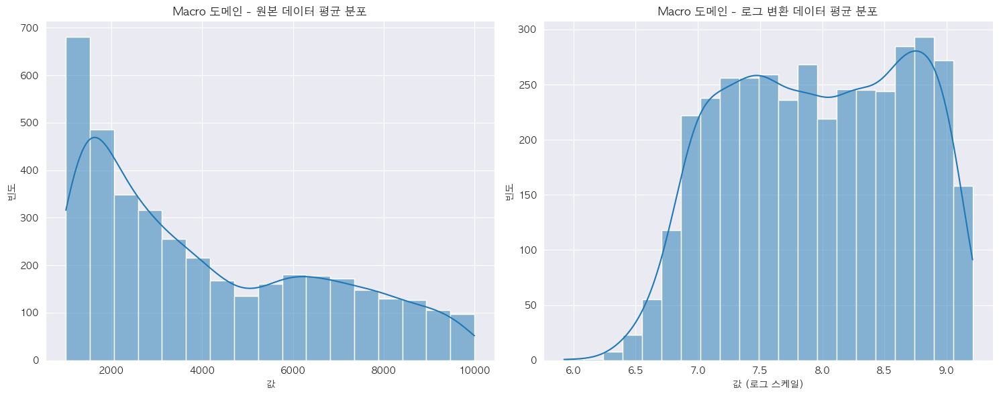

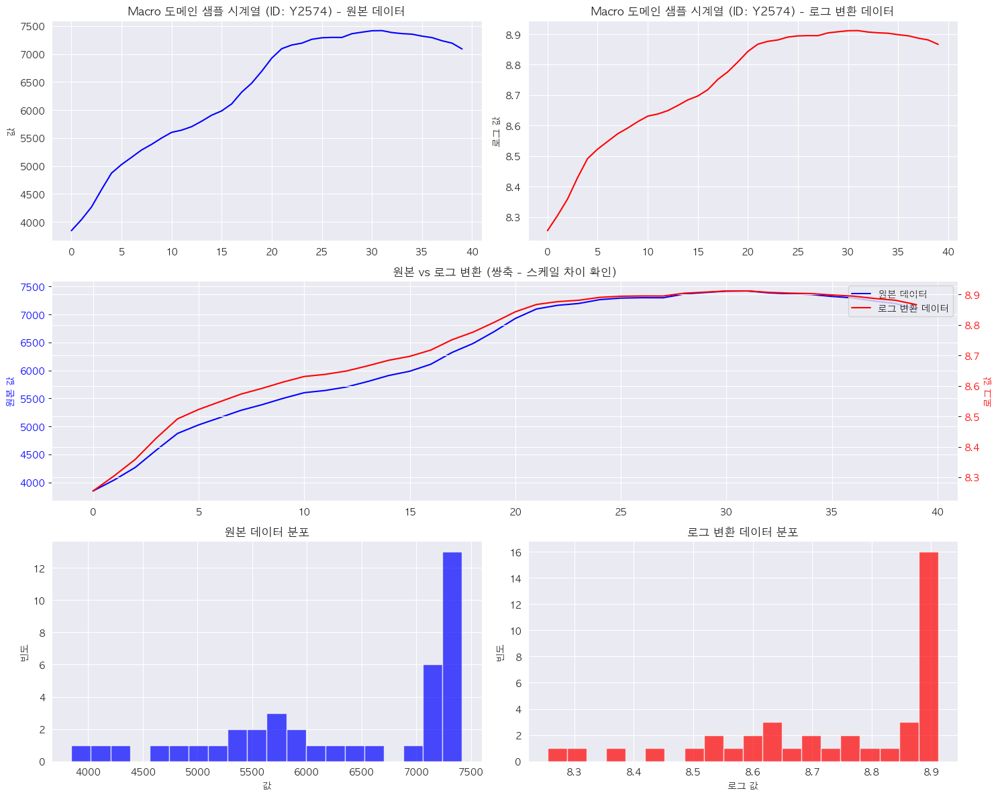

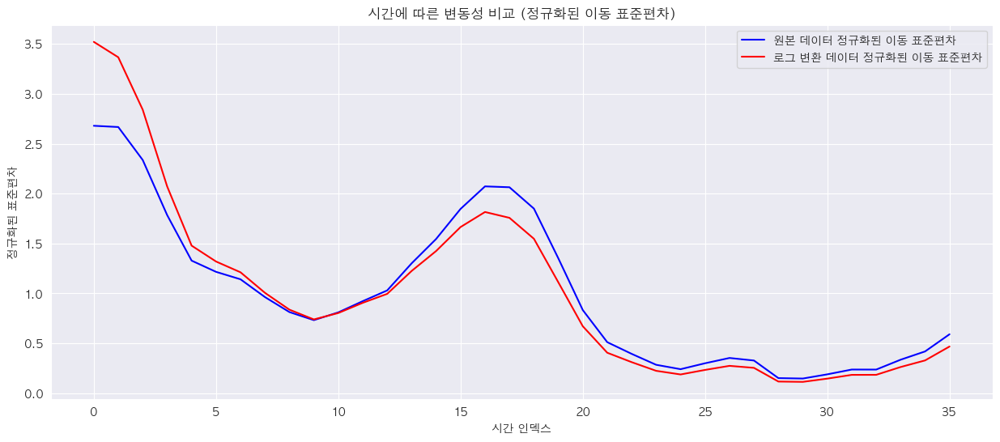


=== Micro 도메인 로그 변환 전후 비교 ===

원본 데이터 통계:
               mean        median           std           min            max  \
count   6538.000000   6538.000000   6538.000000   6538.000000    6538.000000   
mean    3630.598123   3288.916461   1754.668589   1370.529490    7306.608971   
std     2592.008949   2465.907872   1710.830914   1640.547597    5999.142107   
min     1000.103574    263.125703     29.870768     22.100000    1058.294706   
25%     1679.640714   1515.466250    738.533054    310.225000    3364.745000   
50%     2580.332271   2299.500000   1162.145321    679.825000    5125.663000   
75%     5184.023038   4595.812500   2252.055939   1714.824145   10000.000000   
max    69990.000000  66740.500000  42705.935304  10693.000000  158430.000000   

                cv     skewness  
count  6538.000000  6538.000000  
mean      0.500007     0.333354  
std       0.269534     0.562291  
min       0.024460    -4.722645  
25%       0.247307     0.076378  
50%       0.572341     0.350331 

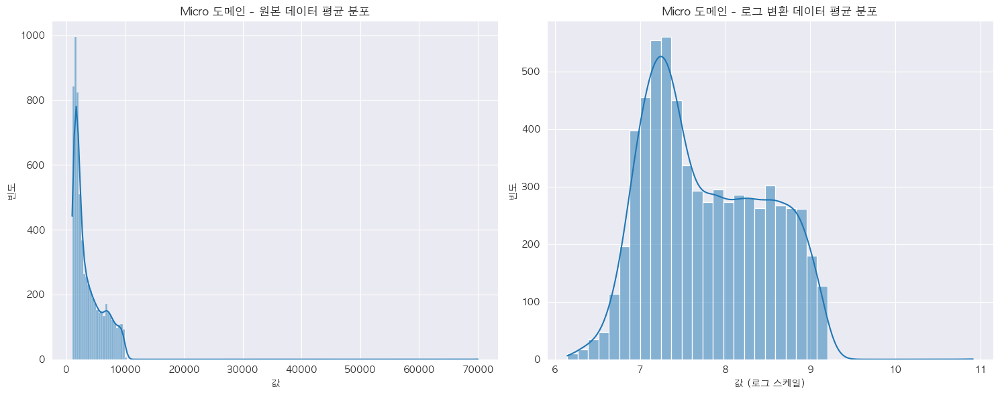

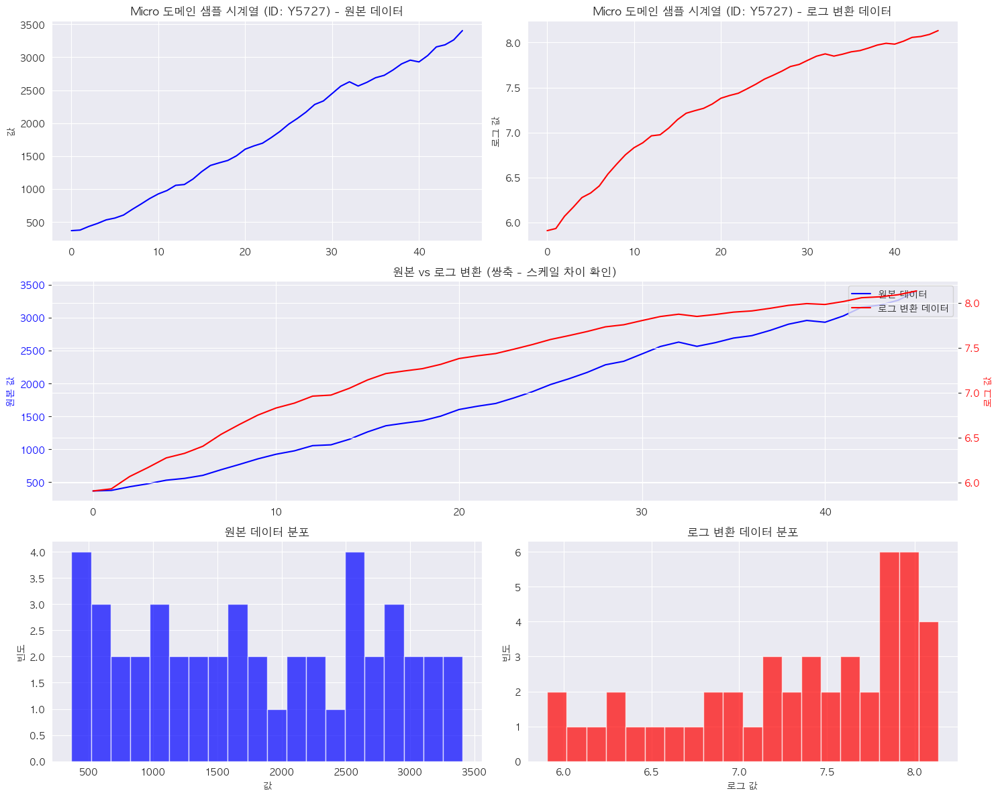

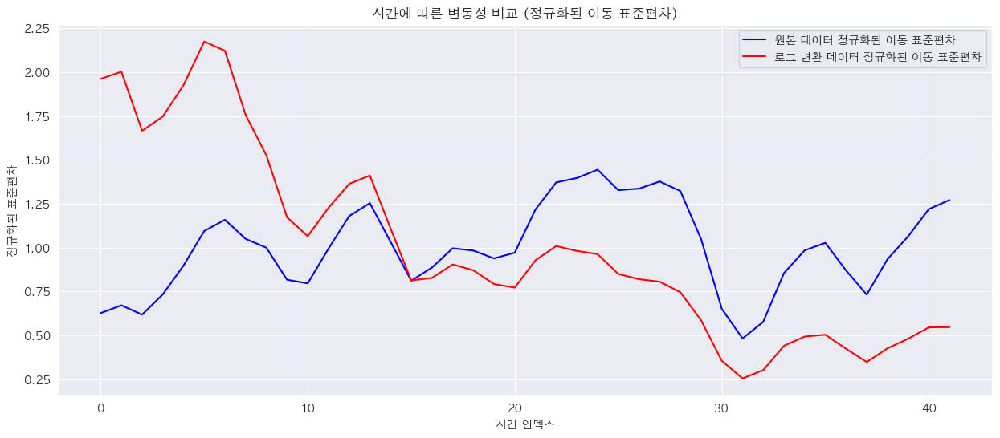


=== Demographic 도메인 로그 변환 전후 비교 ===

원본 데이터 통계:
              mean        median           std          min           max  \
count  1088.000000   1088.000000   1088.000000  1088.000000   1088.000000   
mean   3813.152138   3688.790981   1056.758135  2274.634961   6000.842202   
std    2455.680008   2434.036749   1155.380914  1815.687897   4914.753975   
min    1004.183915    361.868400     25.068024    55.000000   1063.245700   
25%    1778.285511   1703.000000    334.566691   983.605000   2559.589583   
50%    3128.537500   3032.625000    648.633809  1670.200000   4630.350000   
75%    5286.597222   4970.049750   1346.890433  3098.400000   8444.792716   
max    9986.925000  11290.500000  16311.788784  9341.900000  83140.000000   

                cv     skewness  
count  1088.000000  1088.000000  
mean      0.278797     0.176191  
std       0.204302     0.688170  
min       0.023046    -2.640173  
25%       0.125097    -0.251359  
50%       0.224790     0.156469  
75%       0.380415 

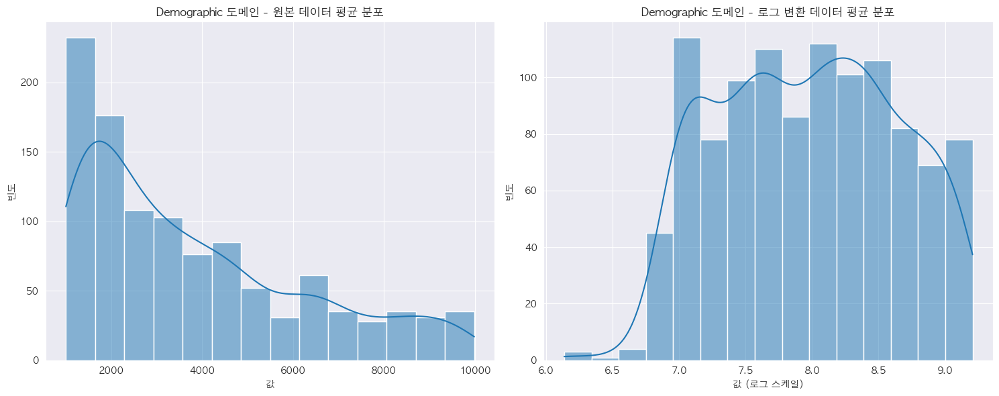

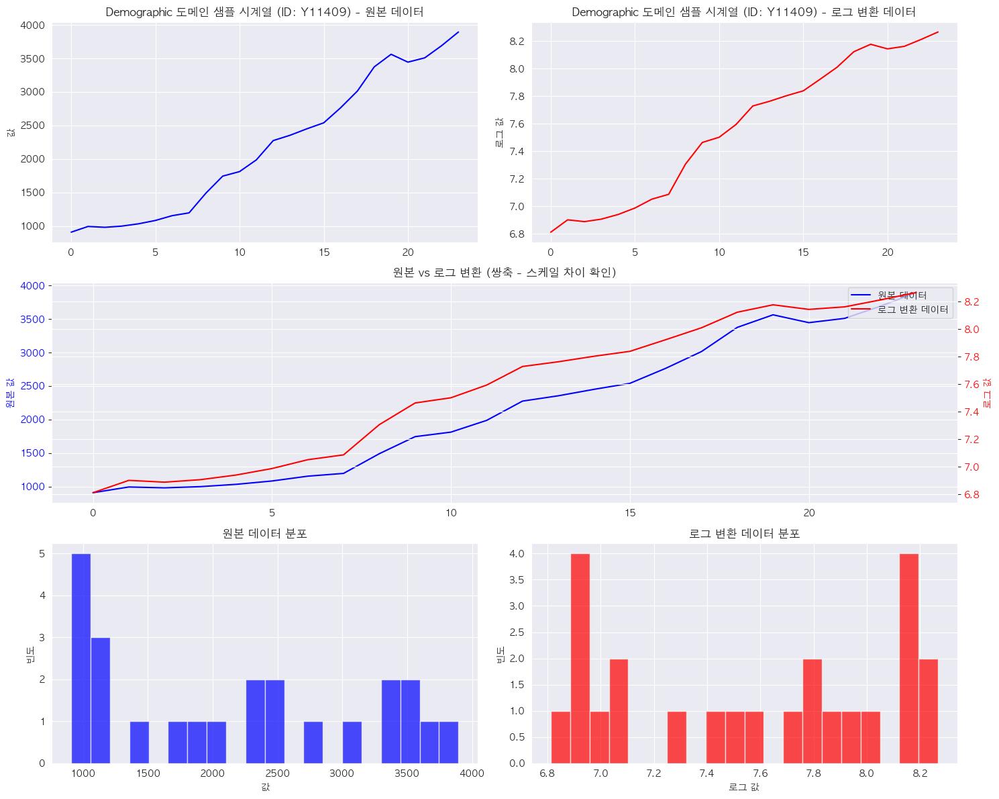

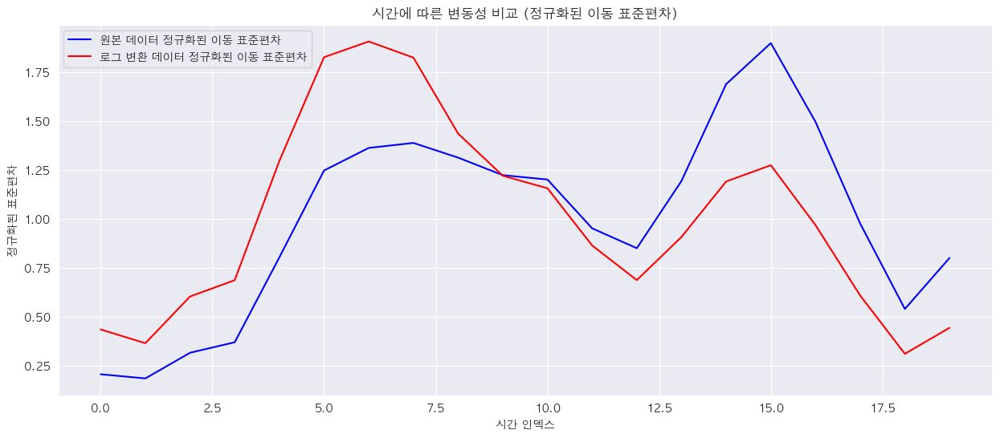


=== Industry 도메인 로그 변환 전후 비교 ===

원본 데이터 통계:
              mean        median           std          min           max  \
count  3716.000000   3716.000000   3716.000000  3716.000000   3716.000000   
mean   4307.521983   4031.799348   1664.862823  2061.860628   7934.261546   
std    2710.528328   2688.981079   1552.819303  1958.115693   5862.398682   
min    1000.126000    261.435000     22.385112    29.000000   1063.833000   
25%    1837.820962   1663.462500    556.555303   657.367500   3270.000000   
50%    3635.402174   3246.980000   1208.206997  1330.450000   6686.150000   
75%    6590.132979   6112.500000   2251.888048  2872.650000  11004.075000   
max    9997.600000  12340.190000  11485.939451  9150.000000  72010.000000   

                cv     skewness  
count  3716.000000  3716.000000  
mean      0.400536     0.352441  
std       0.269607     0.706023  
min       0.021796    -4.304315  
25%       0.183055    -0.084033  
50%       0.331234     0.311629  
75%       0.590023    

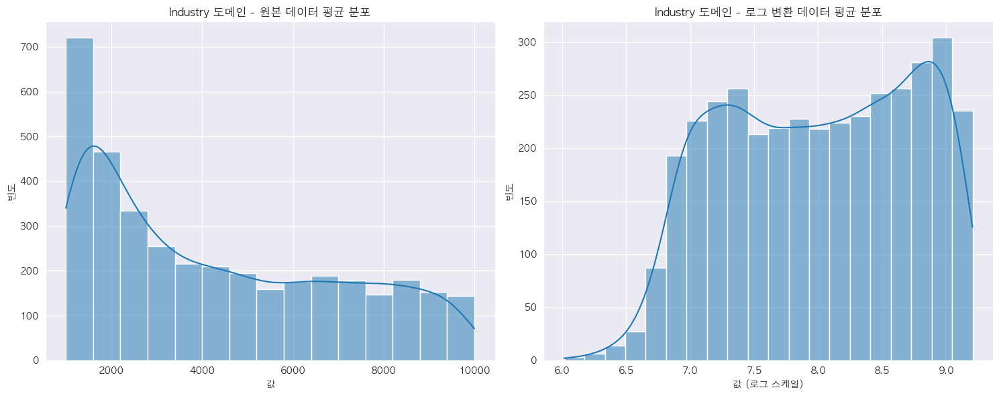

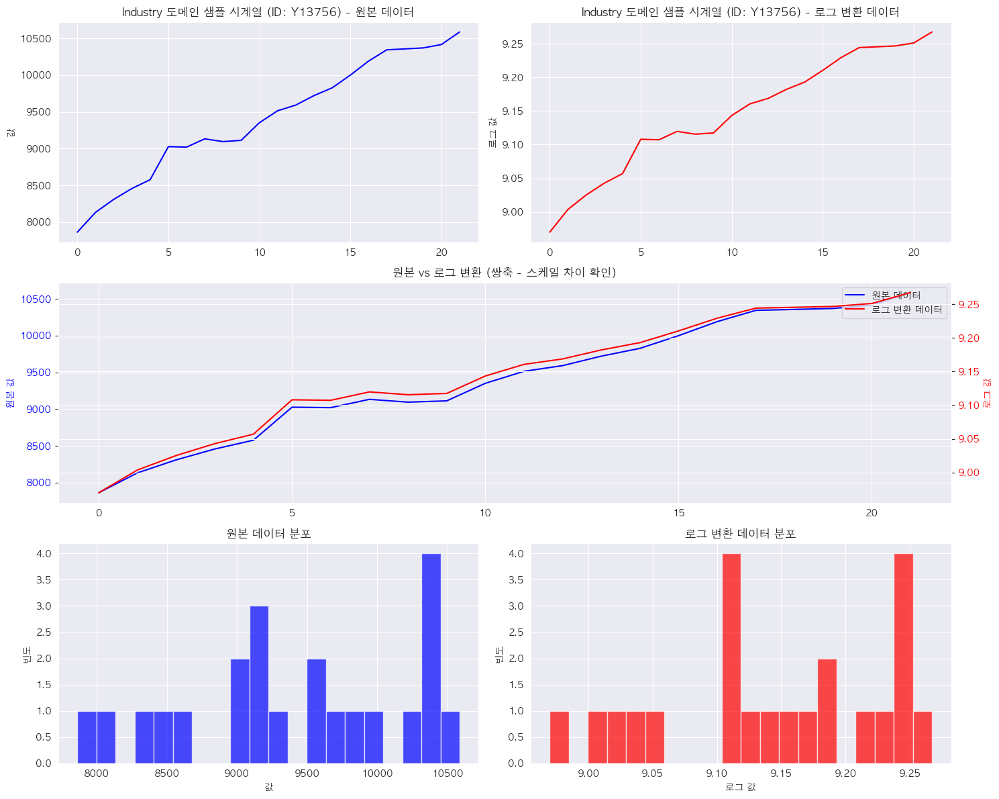

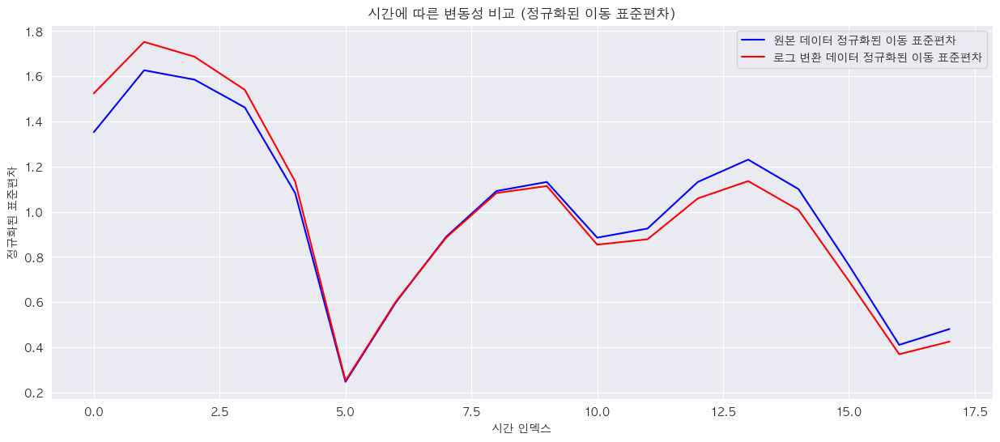


=== Finance 도메인 로그 변환 전후 비교 ===

원본 데이터 통계:
              mean        median           std          min           max  \
count  6519.000000   6519.000000   6519.000000  6519.000000   6519.000000   
mean   4249.396749   3898.026868   1893.607699  1796.368942   8229.839940   
std    2590.773686   2554.895675   1694.341344  1790.772431   5958.786006   
min    1000.059084     96.900000     28.529053    22.000000   1056.300000   
25%    1923.280709   1695.500000    697.708500   512.100000   3637.910000   
50%    3657.822857   3200.000000   1345.856051  1170.180000   6879.020000   
75%    6282.792834   5698.989711   2611.898741  2450.500000  11057.067766   
max    9986.345599  12100.000000  14908.498892  9338.167420  80560.000000   

                cv     skewness  
count  6519.000000  6519.000000  
mean      0.462421     0.329104  
std       0.281631     0.637317  
min       0.023299    -2.844823  
25%       0.230325    -0.057444  
50%       0.427507     0.320970  
75%       0.654428     

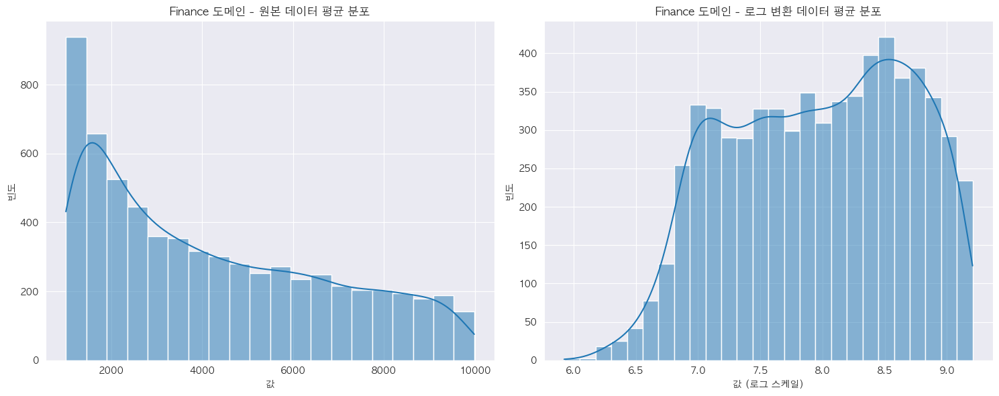

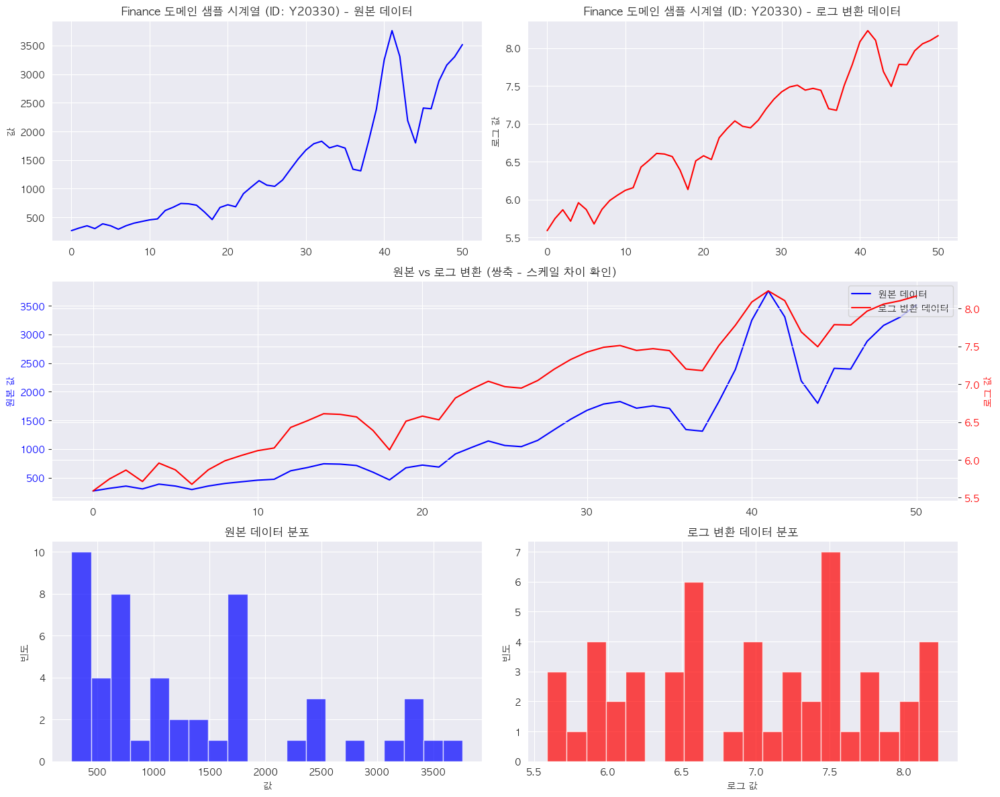

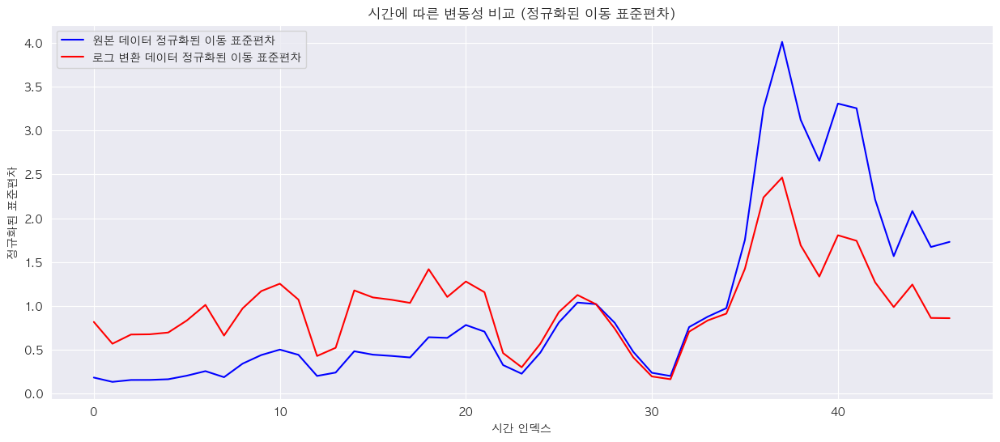


=== Other 도메인 로그 변환 전후 비교 ===

원본 데이터 통계:
              mean        median           std          min           max  \
count  1236.000000   1236.000000   1236.000000  1236.000000   1236.000000   
mean   4896.018533   4638.370591   1559.006941  2717.478892   8093.832335   
std    2852.614991   2865.004652   1322.277962  2294.562185   5030.498120   
min    1000.691291    301.000000     41.611653    29.300000   1092.190000   
25%    2088.440000   1920.112500    624.110174   846.250000   3687.500000   
50%    4865.835714   4293.060000   1271.744036  1909.000000   8500.000000   
75%    7394.119925   7192.225000   2072.581216  4203.567500  10420.450000   
max    9978.878505  10750.000000  10150.546416  9380.000000  40624.100000   

                cv     skewness  
count  1236.000000  1236.000000  
mean      0.355041     0.299170  
std       0.248459     0.666116  
min       0.025410    -3.038261  
25%       0.166726    -0.112413  
50%       0.293982     0.279824  
75%       0.490658     0.

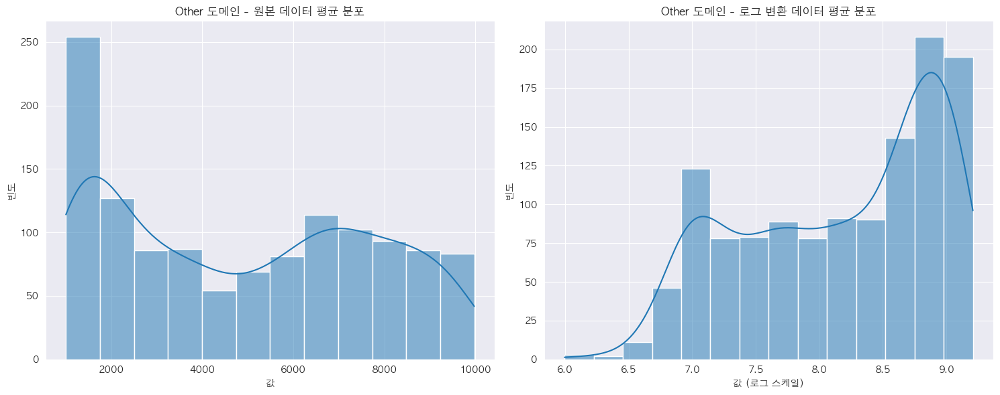

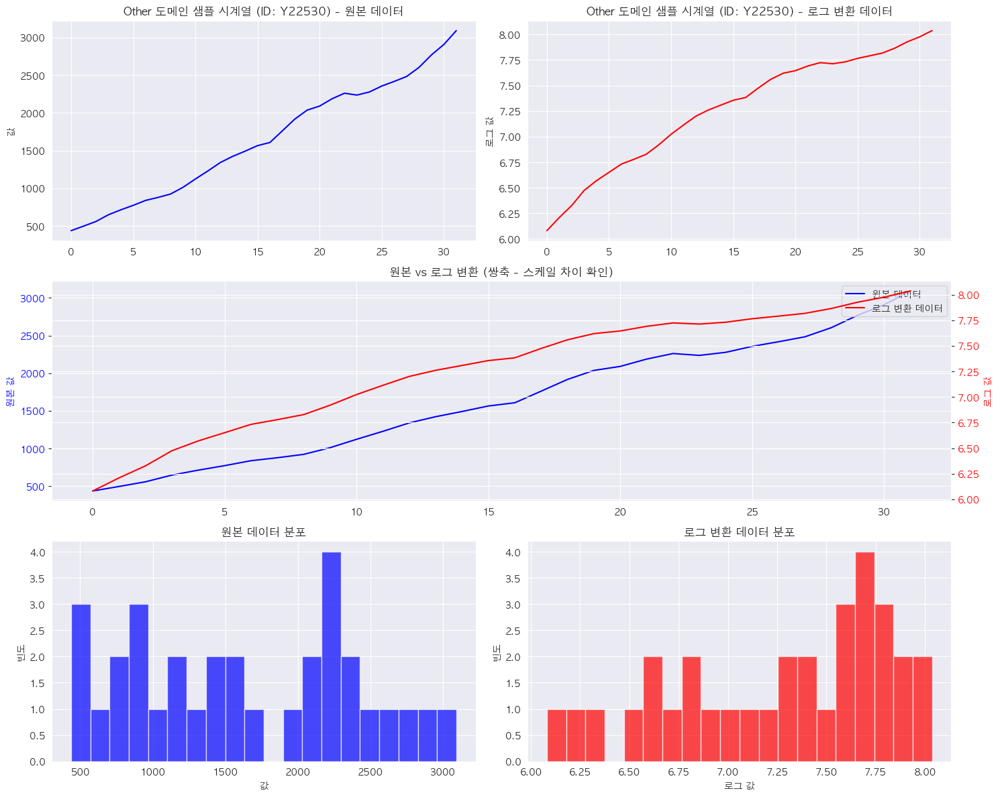

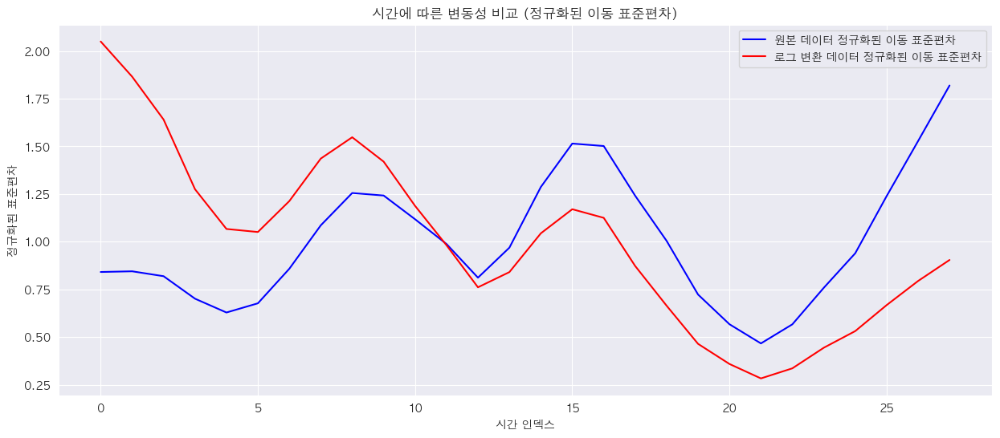

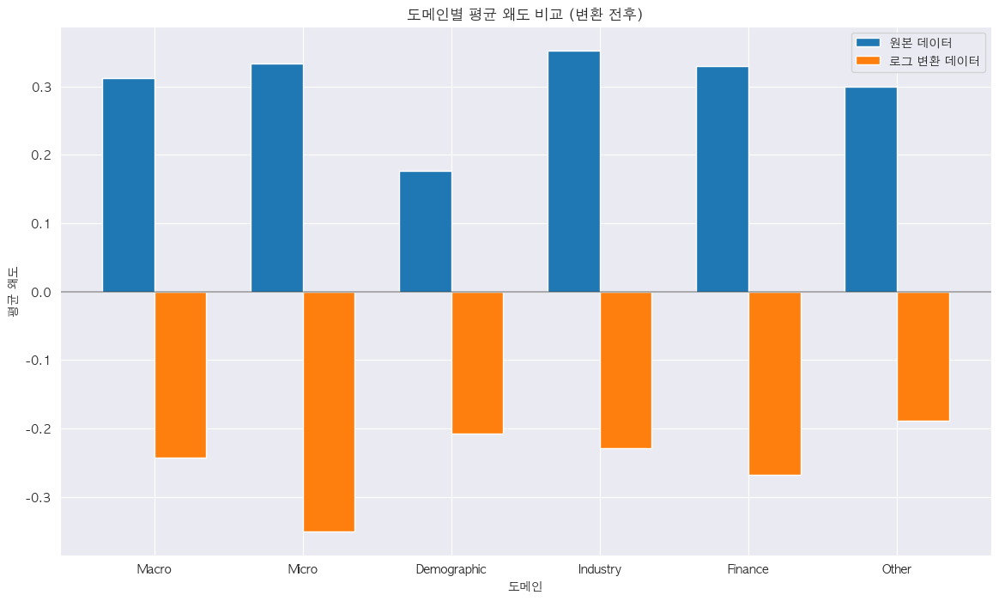

In [9]:
def apply_log_transformation(domain_time_series):
    """
    시계열 데이터에 로그 변환을 적용하고 변환 전/후 통계를 비교합니다.
    각 도메인별 샘플 시계열에 대한 변환 전/후를 시각화합니다.
    """
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    import seaborn as sns
    from scipy import stats
    import random
    from matplotlib.gridspec import GridSpec
    
    # 원본 데이터 통계량 계산
    original_stats = []
    
    # 로그 변환 데이터 저장용 구조
    log_transformed_series = {}
    
    # 각 도메인별 샘플 시계열 ID 저장 (랜덤 선택)
    sample_series_ids = {}
    
    # 각 도메인과 시계열에 대한 처리
    for domain, series_dict in domain_time_series.items():
        if domain not in log_transformed_series:
            log_transformed_series[domain] = {}
            
        # 이 도메인의 랜덤 시계열 ID 선택 (변환 전/후 비교용)
        sample_series_ids[domain] = random.choice(list(series_dict.keys()))
            
        for ts_id, (start_time, values) in series_dict.items():
            # 원본 데이터 통계 계산
            values_clean = np.array([v for v in values if not np.isnan(v)])
            
            if len(values_clean) > 0:
                stat = {
                    'domain': domain,
                    'ts_id': ts_id,
                    'length': len(values),
                    'mean': np.mean(values_clean),
                    'median': np.median(values_clean),
                    'std': np.std(values_clean),
                    'min': np.min(values_clean),
                    'max': np.max(values_clean),
                    'range': np.max(values_clean) - np.min(values_clean),
                    'cv': np.std(values_clean) / np.mean(values_clean) if np.mean(values_clean) != 0 else np.nan,
                    'skewness': stats.skew(values_clean) if len(values_clean) > 2 else np.nan,
                    'transformation': 'original'
                }
                original_stats.append(stat)
                
                # 로그 변환 적용 (NaN 값은 그대로 유지)
                log_values = np.array([np.log(v) if not np.isnan(v) else np.nan for v in values])
                log_transformed_series[domain][ts_id] = (start_time, log_values)
    
    # 로그 변환 데이터 통계량 계산
    log_stats = []
    
    for domain, series_dict in log_transformed_series.items():
        for ts_id, (start_time, values) in series_dict.items():
            # 로그 변환 데이터 통계 계산
            values_clean = np.array([v for v in values if not np.isnan(v)])
            
            if len(values_clean) > 0:
                stat = {
                    'domain': domain,
                    'ts_id': ts_id,
                    'length': len(values),
                    'mean': np.mean(values_clean),
                    'median': np.median(values_clean),
                    'std': np.std(values_clean),
                    'min': np.min(values_clean),
                    'max': np.max(values_clean),
                    'range': np.max(values_clean) - np.min(values_clean),
                    'cv': np.std(values_clean) / np.mean(values_clean) if np.mean(values_clean) != 0 else np.nan,
                    'skewness': stats.skew(values_clean) if len(values_clean) > 2 else np.nan,
                    'transformation': 'log'
                }
                log_stats.append(stat)
    
    # 통계량 DataFrame 생성
    original_df = pd.DataFrame(original_stats)
    log_df = pd.DataFrame(log_stats)
    
    # 두 데이터프레임 합치기
    combined_df = pd.concat([original_df, log_df])
    
    # 도메인별 로그 변환 전후 비교
    domains = original_df['domain'].unique()
    
    # 각 도메인별로 로그 변환 전후 비교 시각화
    for domain in domains:
        domain_original = original_df[original_df['domain'] == domain]
        domain_log = log_df[log_df['domain'] == domain]
        
        # 기본 통계량 출력
        print(f"\n=== {domain} 도메인 로그 변환 전후 비교 ===")
        
        print("\n원본 데이터 통계:")
        print(domain_original[['mean', 'median', 'std', 'min', 'max', 'cv', 'skewness']].describe())
        
        print("\n로그 변환 데이터 통계:")
        print(domain_log[['mean', 'median', 'std', 'min', 'max', 'cv', 'skewness']].describe())
        
        # 원본과 로그 변환 히스토그램 비교 (평균값 분포만 남김)
        plt.figure(figsize=(15, 6))
        
        plt.subplot(1, 2, 1)
        sns.histplot(domain_original['mean'], kde=True)
        plt.title(f'{domain} 도메인 - 원본 데이터 평균 분포')
        plt.xlabel('값')
        plt.ylabel('빈도')
        
        plt.subplot(1, 2, 2)
        sns.histplot(domain_log['mean'], kde=True)
        plt.title(f'{domain} 도메인 - 로그 변환 데이터 평균 분포')
        plt.xlabel('값 (로그 스케일)')
        plt.ylabel('빈도')
        
        plt.tight_layout()
        plt.show()
        
        # 샘플 시계열 데이터 변환 전/후 비교
        sample_id = sample_series_ids[domain]
        
        # 원본 시계열 데이터
        orig_start_time, orig_values = domain_time_series[domain][sample_id]
        # 로그 변환된 시계열 데이터
        log_start_time, log_values = log_transformed_series[domain][sample_id]
        
        # NaN이 아닌 값만 사용하여 시각화
        valid_indices = ~np.isnan(orig_values)
        valid_orig_values = np.array(orig_values)[valid_indices]
        valid_log_values = np.array(log_values)[valid_indices]
        time_indices = np.arange(len(valid_orig_values))
        
        # 변환 전후 차이를 더 명확하게 보여주는 시각화
        fig = plt.figure(figsize=(15, 12))
        gs = GridSpec(3, 2, figure=fig)
        
        # 원본 데이터
        ax1 = fig.add_subplot(gs[0, 0])
        ax1.plot(time_indices, valid_orig_values, 'b-')
        ax1.set_title(f'{domain} 도메인 샘플 시계열 (ID: {sample_id}) - 원본 데이터')
        ax1.set_ylabel('값')
        ax1.grid(True)
        
        # 로그 변환 데이터
        ax2 = fig.add_subplot(gs[0, 1])
        ax2.plot(time_indices, valid_log_values, 'r-')
        ax2.set_title(f'{domain} 도메인 샘플 시계열 (ID: {sample_id}) - 로그 변환 데이터')
        ax2.set_ylabel('로그 값')
        ax2.grid(True)
        
        # 쌍축 그래프 (같은 그래프에 두 데이터 표시)
        ax3 = fig.add_subplot(gs[1, :])
        line1 = ax3.plot(time_indices, valid_orig_values, 'b-', label='원본 데이터')
        ax3.set_ylabel('원본 값', color='b')
        ax3.tick_params(axis='y', labelcolor='b')
        ax3.grid(True)
        
        ax3_twin = ax3.twinx()
        line2 = ax3_twin.plot(time_indices, valid_log_values, 'r-', label='로그 변환 데이터')
        ax3_twin.set_ylabel('로그 값', color='r')
        ax3_twin.tick_params(axis='y', labelcolor='r')
        
        # 범례 추가
        lines = line1 + line2
        labels = [l.get_label() for l in lines]
        ax3.legend(lines, labels, loc='upper right')
        ax3.set_title('원본 vs 로그 변환 (쌍축 - 스케일 차이 확인)')
        
        # 데이터 분포 비교
        ax4 = fig.add_subplot(gs[2, 0])
        ax4.hist(valid_orig_values, bins=20, alpha=0.7, color='b')
        ax4.set_title('원본 데이터 분포')
        ax4.set_xlabel('값')
        ax4.set_ylabel('빈도')
        ax4.grid(True)
        
        ax5 = fig.add_subplot(gs[2, 1])
        ax5.hist(valid_log_values, bins=20, alpha=0.7, color='r')
        ax5.set_title('로그 변환 데이터 분포')
        ax5.set_xlabel('로그 값')
        ax5.set_ylabel('빈도')
        ax5.grid(True)
        
        plt.tight_layout()
        plt.show()
        
        # 변동성 패턴 비교 (이동 표준편차)
        if len(valid_orig_values) > 10:  # 충분한 데이터가 있는 경우에만
            window_size = max(5, len(valid_orig_values) // 10)  # 적절한 윈도우 크기 설정
            
            # 이동 표준편차 계산
            rolling_std_orig = []
            rolling_std_log = []
            
            for i in range(len(valid_orig_values) - window_size + 1):
                rolling_std_orig.append(np.std(valid_orig_values[i:i+window_size]))
                rolling_std_log.append(np.std(valid_log_values[i:i+window_size]))
                
            # 변동성 정규화 (비교를 위해)
            if np.mean(rolling_std_orig) > 0 and np.mean(rolling_std_log) > 0:
                norm_std_orig = np.array(rolling_std_orig) / np.mean(rolling_std_orig)
                norm_std_log = np.array(rolling_std_log) / np.mean(rolling_std_log)
                
                plt.figure(figsize=(15, 6))
                plt.plot(range(len(norm_std_orig)), norm_std_orig, 'b-', 
                         label='원본 데이터 정규화된 이동 표준편차')
                plt.plot(range(len(norm_std_log)), norm_std_log, 'r-', 
                         label='로그 변환 데이터 정규화된 이동 표준편차')
                plt.title('시간에 따른 변동성 비교 (정규화된 이동 표준편차)')
                plt.xlabel('시간 인덱스')
                plt.ylabel('정규화된 표준편차')
                plt.legend()
                plt.grid(True)
                plt.show()
    
    # 전체 도메인 변환 전후 왜도 비교
    plt.figure(figsize=(14, 8))
    
    skew_comparison = pd.DataFrame({
        'domain': domains,
        'original_skew': [original_df[original_df['domain'] == d]['skewness'].mean() for d in domains],
        'log_skew': [log_df[log_df['domain'] == d]['skewness'].mean() for d in domains]
    })
    
    bar_width = 0.35
    x = np.arange(len(domains))
    
    plt.bar(x - bar_width/2, skew_comparison['original_skew'], bar_width, label='원본 데이터')
    plt.bar(x + bar_width/2, skew_comparison['log_skew'], bar_width, label='로그 변환 데이터')
    
    plt.axhline(y=0, color='k', linestyle='-', alpha=0.3)
    plt.xticks(x, domains)
    plt.title('도메인별 평균 왜도 비교 (변환 전후)')
    plt.xlabel('도메인')
    plt.ylabel('평균 왜도')
    plt.legend()
    plt.grid(True, axis='y')
    plt.show()
    
    return log_transformed_series, combined_df

# 함수 실행
log_transformed_series, transformation_stats = apply_log_transformation(domain_time_series)

In [10]:
log_transformed_series

{'Macro': {'Y1': ('1979-01-01 12:00:00',
   array([8.55103407, 8.54354297, 8.5538915 , 8.53397164, 8.55294636,
          8.59679888, 8.62626282, 8.65745935, 8.69202007, 8.71404205,
          8.73855916, 8.75103135, 8.74236668, 8.75794088, 8.76832538,
          8.8031087 , 8.82987027, 8.84296553, 8.86411069, 8.87402812,
          8.8860773 , 8.90240117, 8.90098512, 8.88886709, 8.89488963,
          8.90841061, 8.93074551, 8.94264392, 8.93423108, 8.92671672,
          8.89028661, 8.89428626, 8.90823478, 8.92633154, 8.93521908,
          8.95166031, 8.96484896])),
  'Y2': ('1979-01-01 12:00:00',
   array([7.63530389, 7.65159557, 7.78072089, 7.40913644, 7.30787278,
          7.20637729, 7.08840878, 7.08338785, 7.00760061, 6.91572345,
          6.90173721, 7.25841215, 7.36644515, 7.1592919 , 7.03262426,
          7.18690102, 7.05358573, 7.12608727, 7.51914996, 7.49220304,
          7.2626286 , 7.06475903, 6.92853782, 6.90475077, 6.9679092 ,
          6.9206715 , 6.85012617, 6.7580945 , 6.90

### 각 도메인 별 차분 적용 및 ACF, PACF 확인


도메인: Macro 차분 분석


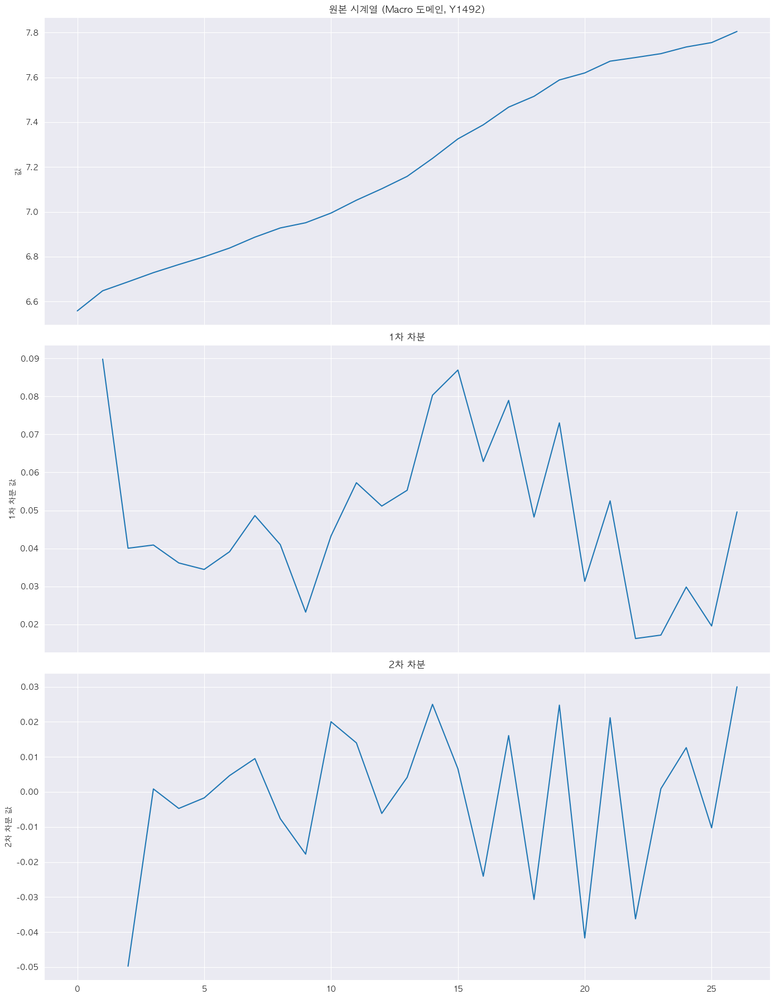


=== 원본 시계열 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: 0.4623
  p-value: 0.9837
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.7763
  p-value: 0.0100
  정상성 여부: 비정상

=== 1차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -3.5832
  p-value: 0.0061
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.1332
  p-value: 0.1000
  정상성 여부: 정상

=== 2차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -1.7058
  p-value: 0.4281
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.1523
  p-value: 0.1000
  정상성 여부: 정상


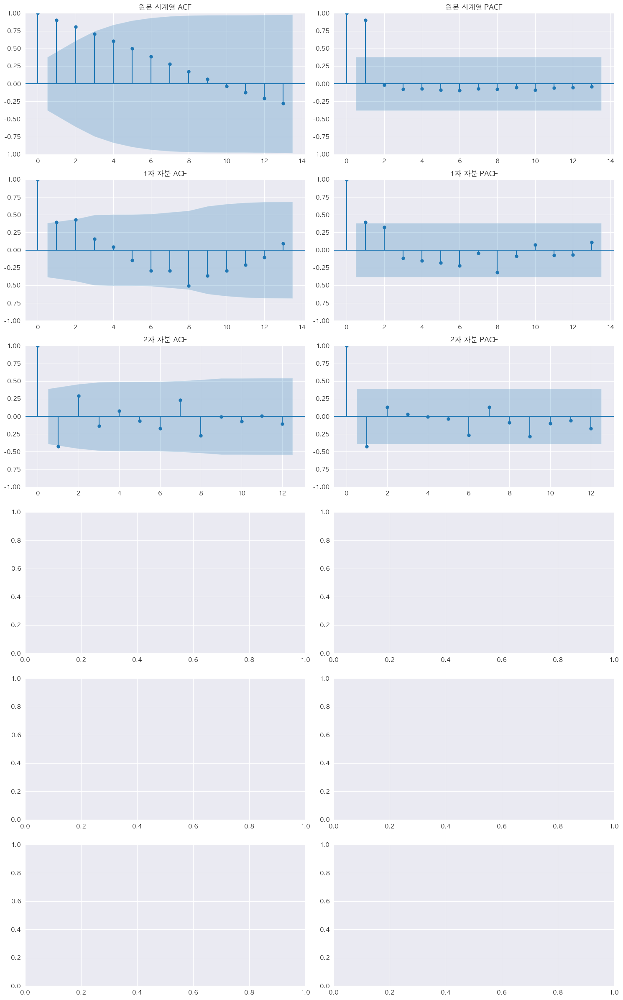


도메인: Micro 차분 분석


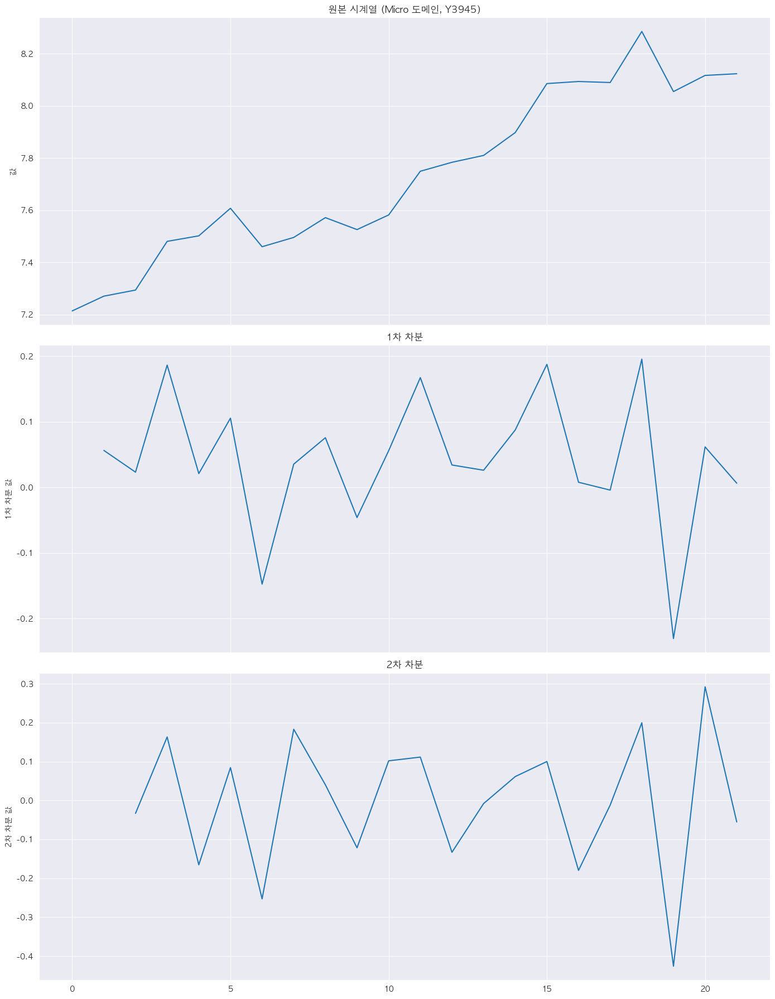


=== 원본 시계열 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -0.6363
  p-value: 0.8626
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.7961
  p-value: 0.0100
  정상성 여부: 비정상

=== 1차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -6.0986
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.1371
  p-value: 0.1000
  정상성 여부: 정상

=== 2차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -6.7360
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.1857
  p-value: 0.1000
  정상성 여부: 정상


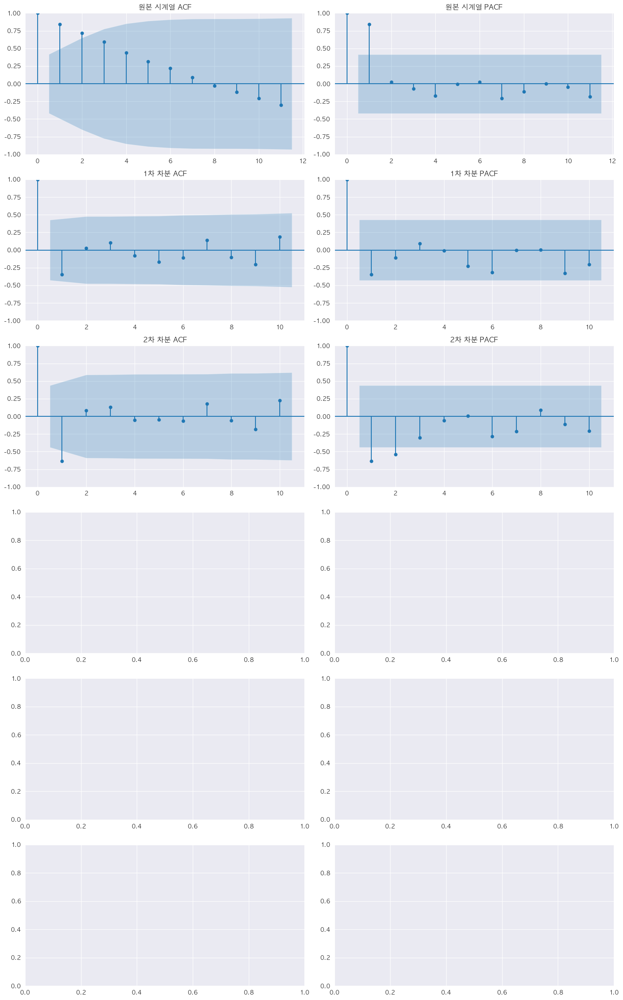


도메인: Demographic 차분 분석


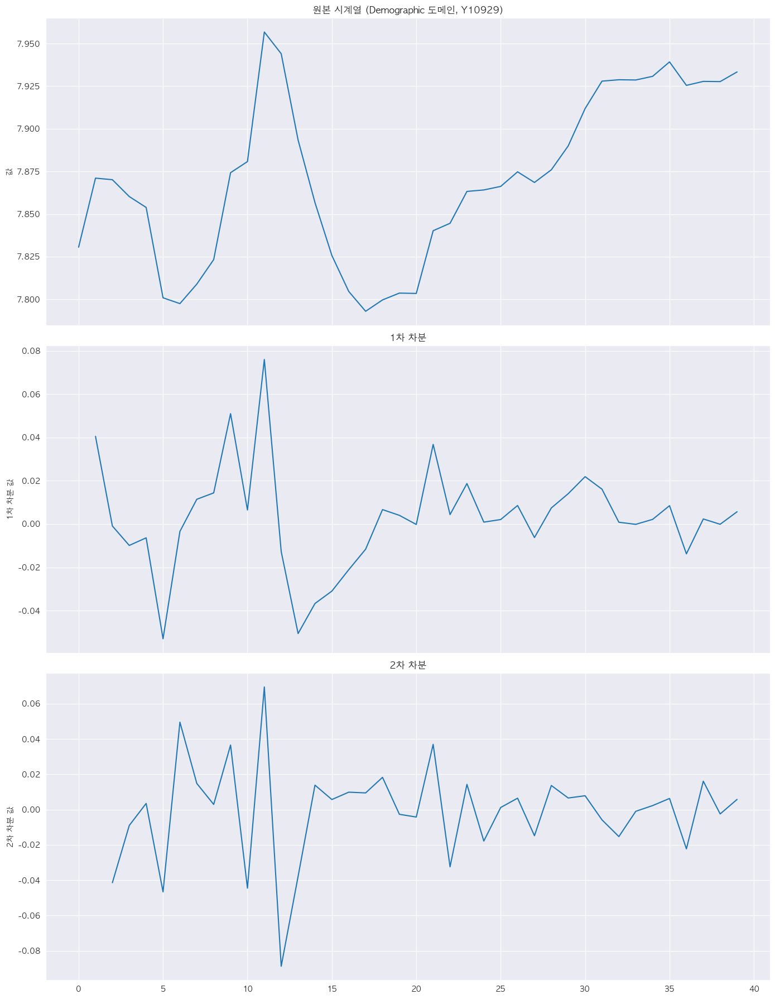


=== 원본 시계열 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -2.3746
  p-value: 0.1490
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.4142
  p-value: 0.0710
  정상성 여부: 정상

=== 1차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -4.6085
  p-value: 0.0001
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.0517
  p-value: 0.1000
  정상성 여부: 정상

=== 2차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -9.3097
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.0681
  p-value: 0.1000
  정상성 여부: 정상


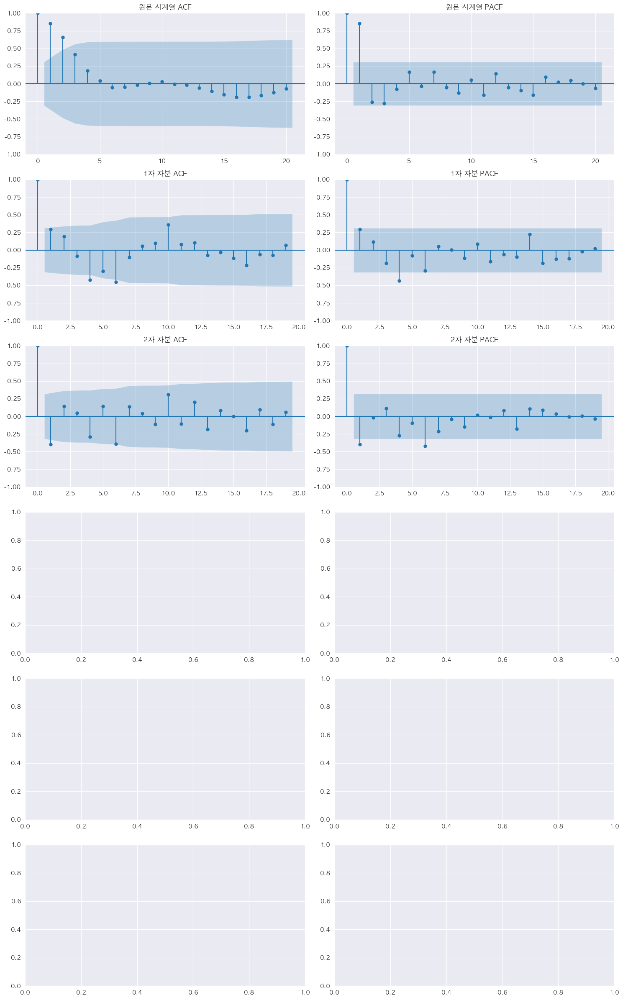


도메인: Industry 차분 분석


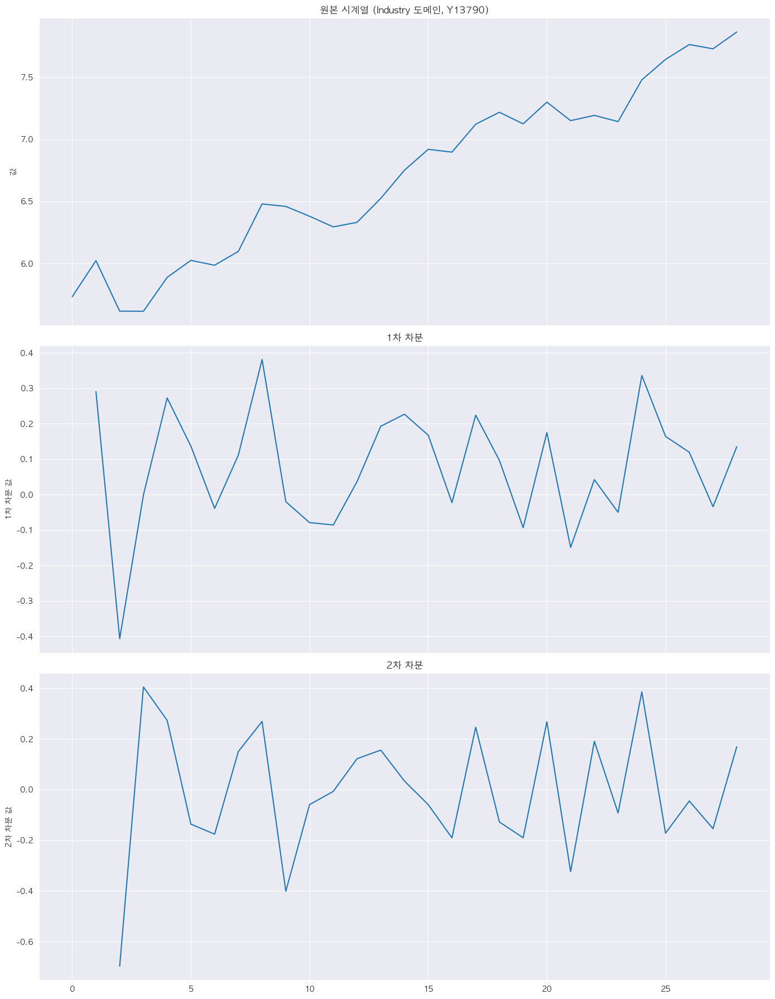


=== 원본 시계열 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -0.3471
  p-value: 0.9186
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.8125
  p-value: 0.0100
  정상성 여부: 비정상

=== 1차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -5.8330
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.2448
  p-value: 0.1000
  정상성 여부: 정상

=== 2차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -8.7267
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.5000
  p-value: 0.0417
  정상성 여부: 비정상


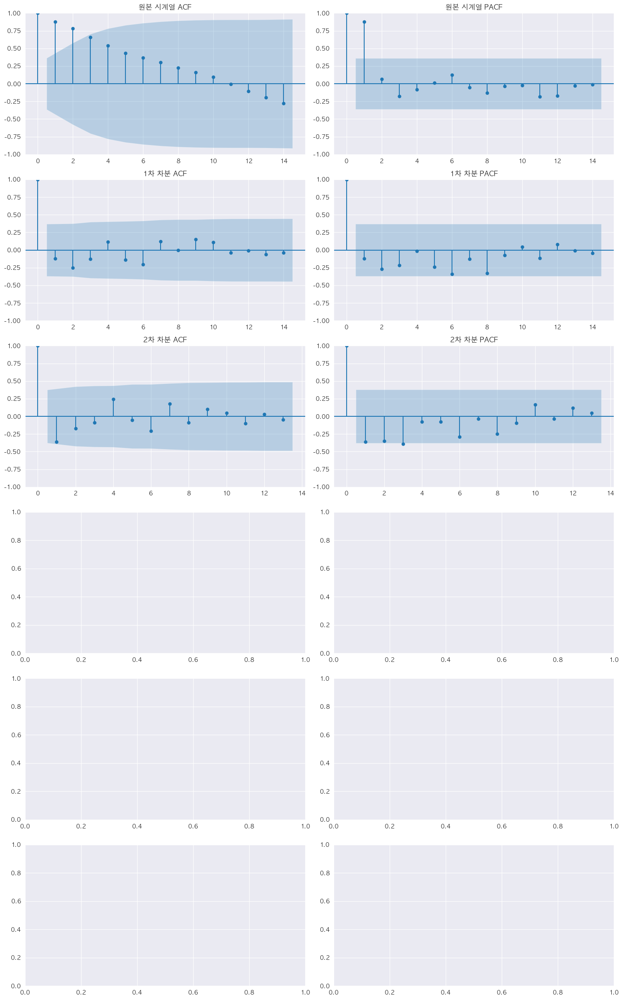


도메인: Finance 차분 분석


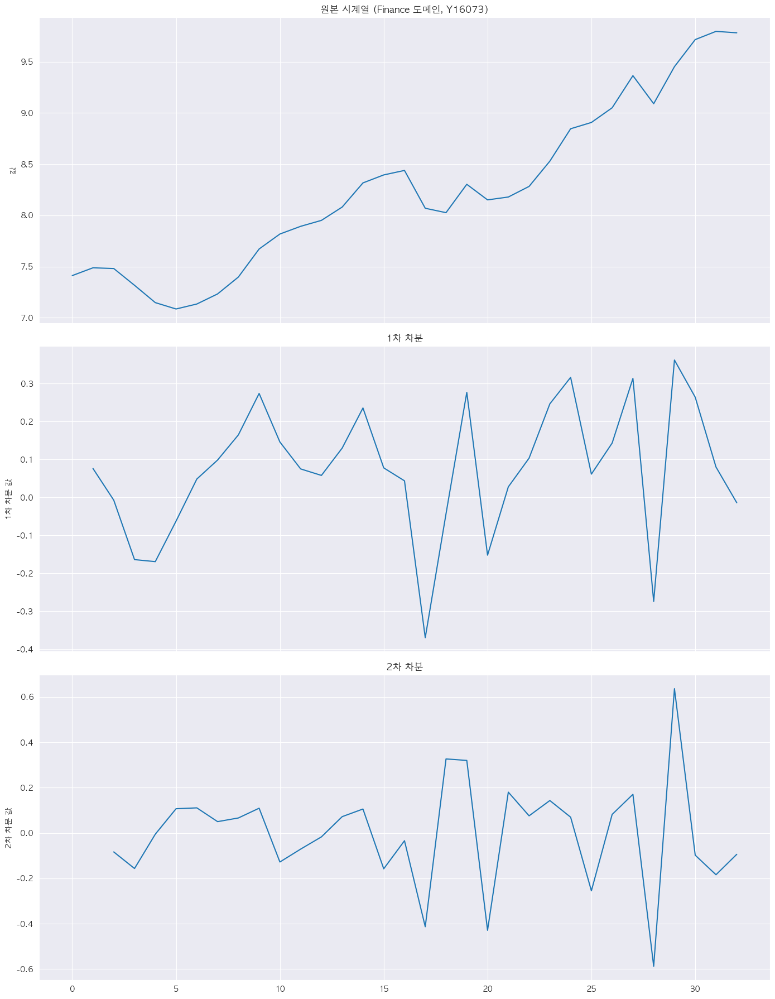


=== 원본 시계열 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: 0.5518
  p-value: 0.9864
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.8482
  p-value: 0.0100
  정상성 여부: 비정상

=== 1차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -4.8478
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.2248
  p-value: 0.1000
  정상성 여부: 정상

=== 2차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -6.7524
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.3013
  p-value: 0.1000
  정상성 여부: 정상


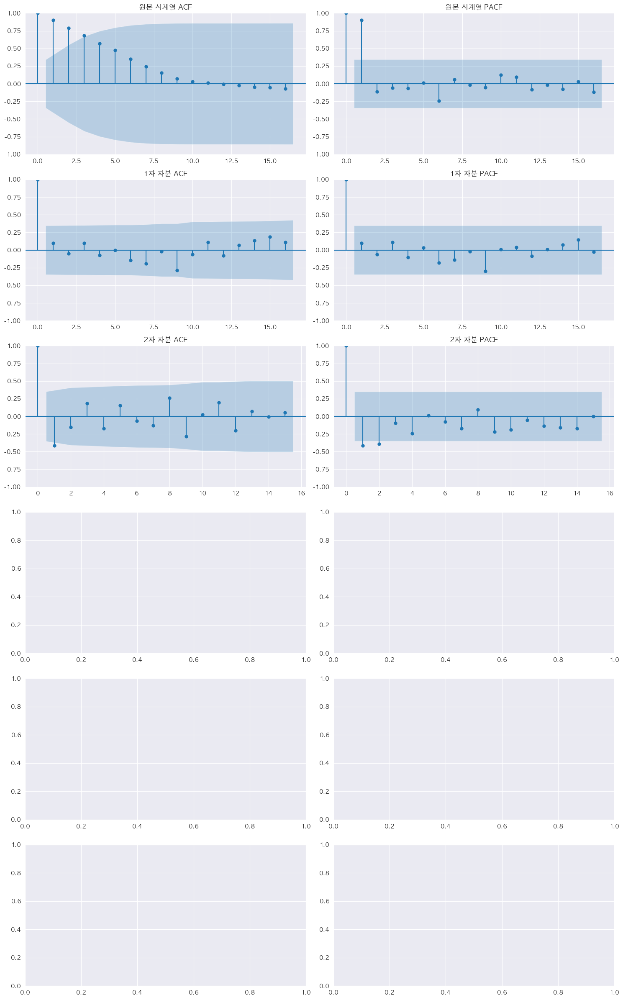


도메인: Other 차분 분석


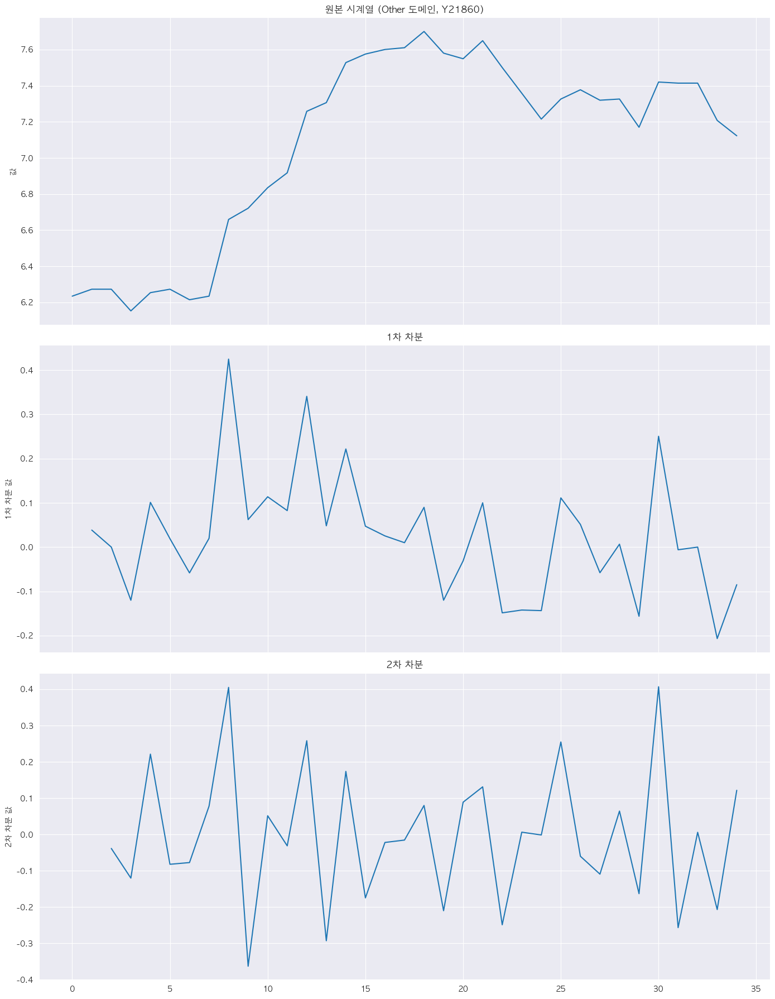


=== 원본 시계열 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -4.8841
  p-value: 0.0000
  정상성 여부: 정상
KPSS 검정 결과:
  KPSS 통계량: 0.5233
  p-value: 0.0364
  정상성 여부: 비정상

=== 1차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -1.9941
  p-value: 0.2892
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.3849
  p-value: 0.0837
  정상성 여부: 정상

=== 2차 차분 정상성 검정 ===
ADF 검정 결과:
  ADF 통계량: -2.5508
  p-value: 0.1036
  정상성 여부: 비정상
KPSS 검정 결과:
  KPSS 통계량: 0.1579
  p-value: 0.1000
  정상성 여부: 정상


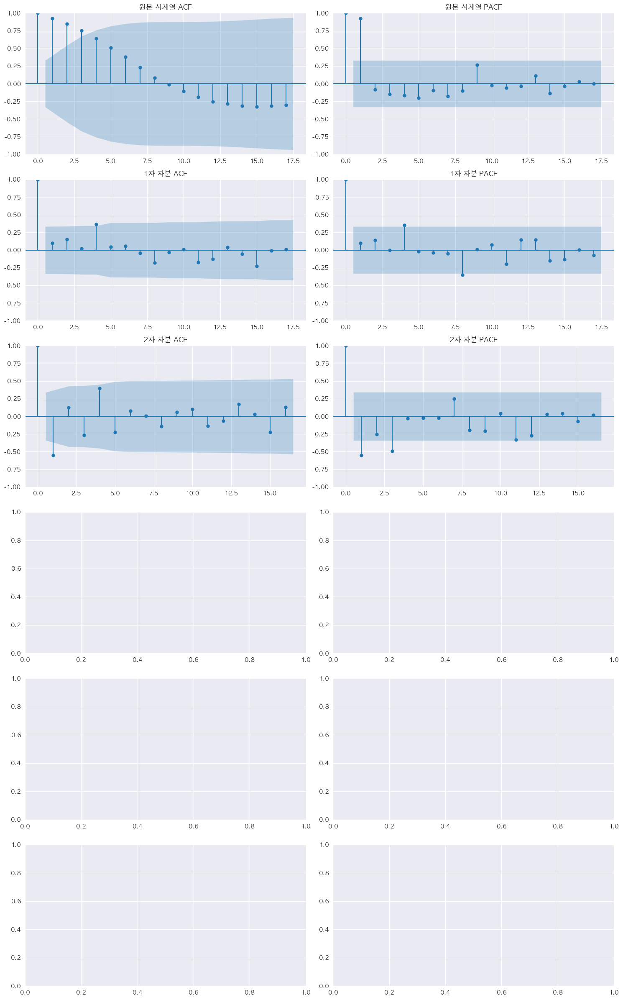

In [11]:
def apply_and_visualize_differencing(domain_time_series, domain, ts_id=None):
    """
    특정 도메인의 시계열 데이터에 다양한 차분을 적용하고 시각화합니다:
    1. 1차 차분
    2. 2차 차분
    3. 계절 차분(4 주기)
    4. 계절 차분 + 1차 차분
    5. 계절 차분 + 2차 차분
    
    각 단계별로 ADF 및 KPSS 정상성 검정을 수행합니다.
    """
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    import random
    from statsmodels.tsa.stattools import adfuller, kpss
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    import warnings
    
    # 경고 숨기기
    warnings.filterwarnings("ignore")
    
    # 도메인에서 시계열 선택
    if ts_id is None:
        ts_id = random.choice(list(domain_time_series[domain].keys()))
    
    start_time, values = domain_time_series[domain][ts_id]
    values_np = np.array(values)
    
    # 결측값 처리
    mask = ~np.isnan(values_np)
    values_clean = values_np[mask]
    
    # 값이 너무 적으면 다른 시계열 선택
    if len(values_clean) < 10:
        print(f"시계열 {ts_id}의 유효 데이터가 너무 적습니다. 다른 시계열을 선택하세요.")
        return None
    
    # pandas Series로 변환 (날짜 인덱스 포함)
    if isinstance(start_time, str):
        start_time = pd.to_datetime(start_time)
    
    # 인덱스가 중요하지 않다면 정수 인덱스로 대체 가능
    original_series = pd.Series(values_clean)
    
    # 차분 적용
    # 1. 1차 차분
    diff1 = original_series.diff().dropna()
    
    # 2. 2차 차분
    diff2 = diff1.diff().dropna()
    
    # 차분 적용 결과 시각화
    fig, axes = plt.subplots(3, 1, figsize=(14, 18), sharex=True)
    
    # 원본 시계열
    original_series.plot(ax=axes[0], title=f'원본 시계열 ({domain} 도메인, {ts_id})')
    axes[0].set_ylabel('값')
    axes[0].grid(True)
    
    # 1차 차분
    if len(diff1) > 0:
        diff1.plot(ax=axes[1], title=f'1차 차분')
    else:
        axes[1].text(0.5, 0.5, "데이터 부족으로 계산 불가", ha='center', va='center')
    axes[1].set_ylabel('1차 차분 값')
    axes[1].grid(True)
    
    # 2차 차분
    if len(diff2) > 0:
        diff2.plot(ax=axes[2], title=f'2차 차분')
    else:
        axes[2].text(0.5, 0.5, "데이터 부족으로 계산 불가", ha='center', va='center')
    axes[2].set_ylabel('2차 차분 값')
    axes[2].grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # 정상성 검정 함수
    def run_stationarity_tests(series, name):
        print(f"\n=== {name} 정상성 검정 ===")
        
        if len(series) < 8:  # 테스트에 필요한 최소 데이터 길이
            print(f"데이터 길이가 충분하지 않아 검정을 수행할 수 없습니다.")
            return
        
        try:
            # ADF 검정
            adf_result = adfuller(series.dropna())
            print(f"ADF 검정 결과:")
            print(f'  ADF 통계량: {adf_result[0]:.4f}')
            print(f'  p-value: {adf_result[1]:.4f}')
            print(f'  정상성 여부: {"정상" if adf_result[1] < 0.05 else "비정상"}')
        except:
            print("ADF 검정 실패 - 시계열 특성이나 길이 문제일 수 있습니다.")
        
        try:
            # KPSS 검정
            kpss_result = kpss(series.dropna())
            print(f"KPSS 검정 결과:")
            print(f'  KPSS 통계량: {kpss_result[0]:.4f}')
            print(f'  p-value: {kpss_result[1]:.4f}')
            print(f'  정상성 여부: {"정상" if kpss_result[1] > 0.05 else "비정상"}')
        except:
            print("KPSS 검정 실패 - 시계열 특성이나 길이 문제일 수 있습니다.")
    
    # 각 시계열에 대한 정상성 검정
    run_stationarity_tests(original_series, "원본 시계열")
    run_stationarity_tests(diff1, "1차 차분")
    run_stationarity_tests(diff2, "2차 차분")
    
    # 각 시계열의 ACF/PACF 시각화
    fig, axes = plt.subplots(6, 2, figsize=(15, 24))
    
    # 차분별 시계열 및 이름 목록
    series_list = [
        (original_series, "원본 시계열"),
        (diff1, "1차 차분"),
        (diff2, "2차 차분")
    ]
    
    # 각 시계열에 대한 ACF/PACF 시각화
    for i, (series, name) in enumerate(series_list):
        if len(series) > 3:  # ACF/PACF에 필요한 최소 데이터 길이 확인
            try:
                # ACF 플롯
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")
                    plot_acf(series.dropna(), lags=min(48, len(series) // 2), ax=axes[i, 0])
                axes[i, 0].set_title(f'{name} ACF')
                
                # PACF 플롯
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")
                    plot_pacf(series.dropna(), lags=min(48, len(series) // 2), ax=axes[i, 1])
                axes[i, 1].set_title(f'{name} PACF')
            except:
                axes[i, 0].text(0.5, 0.5, f"ACF 계산 실패", ha='center', va='center')
                axes[i, 1].text(0.5, 0.5, f"PACF 계산 실패", ha='center', va='center')
        else:
            axes[i, 0].text(0.5, 0.5, f"데이터 부족으로 계산 불가", ha='center', va='center')
            axes[i, 1].text(0.5, 0.5, f"데이터 부족으로 계산 불가", ha='center', va='center')
        
        axes[i, 0].set_title(f'{name} ACF')
        axes[i, 1].set_title(f'{name} PACF')
    
    plt.tight_layout()
    plt.show()
    
    # 결과 시계열 반환
    return {
        "domain": domain,
        "ts_id": ts_id,
        "original": original_series,
        "diff1": diff1,
        "diff2": diff2
    }

# 각 도메인별로 시계열 하나씩 선택하여 차분 분석 실행
def analyze_domain_differencing(domain_time_series):
    """
    각 도메인별로 시계열 하나씩 선택하여 차분 분석을 수행합니다.
    """
    import random
    
    differencing_results = {}
    
    for domain in domain_time_series.keys():
        print(f"\n{'='*50}")
        print(f"도메인: {domain} 차분 분석")
        print(f"{'='*50}")
        
        # 각 도메인에서 데이터 길이가 충분한 시계열 찾기
        valid_ts_ids = []
        for ts_id, (_, values) in domain_time_series[domain].items():
            if sum(~np.isnan(values)) >= 20:  # 최소 20개의 유효한 데이터 포인트 필요
                valid_ts_ids.append(ts_id)
        
        if not valid_ts_ids:
            print(f"{domain} 도메인에 충분한 데이터를 가진 시계열이 없습니다.")
            continue
        
        # 충분한 데이터를 가진 시계열 중 랜덤하게 선택
        ts_id = random.choice(valid_ts_ids)
        
        # 선택된 시계열에 대해 차분 분석 수행
        result = apply_and_visualize_differencing(domain_time_series, domain, ts_id)
        if result:
            differencing_results[domain] = result
        
    return differencing_results

# 모든 도메인에 대해 차분 분석 실행
all_domain_differencing = analyze_domain_differencing(log_transformed_series)def apply_and_visualize_differencing(domain_time_series, domain, ts_id=None):
    """
    특정 도메인의 시계열 데이터에 다양한 차분을 적용하고 시각화합니다:
    1. 1차 차분
    2. 2차 차분
    3. 계절 차분(4 주기)
    4. 계절 차분 + 1차 차분
    5. 계절 차분 + 2차 차분
    
    각 단계별로 ADF 및 KPSS 정상성 검정을 수행합니다.
    """
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    import random
    from statsmodels.tsa.stattools import adfuller, kpss
    from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
    import warnings
    
    # 경고 숨기기
    warnings.filterwarnings("ignore")
    
    # 도메인에서 시계열 선택
    if ts_id is None:
        ts_id = random.choice(list(domain_time_series[domain].keys()))
    
    start_time, values = domain_time_series[domain][ts_id]
    values_np = np.array(values)
    
    # 결측값 처리
    mask = ~np.isnan(values_np)
    values_clean = values_np[mask]
    
    # 값이 너무 적으면 다른 시계열 선택
    if len(values_clean) < 10:
        print(f"시계열 {ts_id}의 유효 데이터가 너무 적습니다. 다른 시계열을 선택하세요.")
        return None
    
    # pandas Series로 변환 (날짜 인덱스 포함)
    if isinstance(start_time, str):
        start_time = pd.to_datetime(start_time)
    
    # 인덱스가 중요하지 않다면 정수 인덱스로 대체 가능
    original_series = pd.Series(values_clean)
    
    # 차분 적용
    # 1. 1차 차분
    diff1 = original_series.diff().dropna()
    
    # 2. 2차 차분
    diff2 = diff1.diff().dropna()
    
    # 차분 적용 결과 시각화
    fig, axes = plt.subplots(3, 1, figsize=(14, 18), sharex=True)
    
    # 원본 시계열
    original_series.plot(ax=axes[0], title=f'원본 시계열 ({domain} 도메인, {ts_id})')
    axes[0].set_ylabel('값')
    axes[0].grid(True)
    
    # 1차 차분
    if len(diff1) > 0:
        diff1.plot(ax=axes[1], title=f'1차 차분')
    else:
        axes[1].text(0.5, 0.5, "데이터 부족으로 계산 불가", ha='center', va='center')
    axes[1].set_ylabel('1차 차분 값')
    axes[1].grid(True)
    
    # 2차 차분
    if len(diff2) > 0:
        diff2.plot(ax=axes[2], title=f'2차 차분')
    else:
        axes[2].text(0.5, 0.5, "데이터 부족으로 계산 불가", ha='center', va='center')
    axes[2].set_ylabel('2차 차분 값')
    axes[2].grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # 정상성 검정 함수
    def run_stationarity_tests(series, name):
        print(f"\n=== {name} 정상성 검정 ===")
        
        if len(series) < 8:  # 테스트에 필요한 최소 데이터 길이
            print(f"데이터 길이가 충분하지 않아 검정을 수행할 수 없습니다.")
            return
        
        try:
            # ADF 검정
            adf_result = adfuller(series.dropna())
            print(f"ADF 검정 결과:")
            print(f'  ADF 통계량: {adf_result[0]:.4f}')
            print(f'  p-value: {adf_result[1]:.4f}')
            print(f'  정상성 여부: {"정상" if adf_result[1] < 0.05 else "비정상"}')
        except:
            print("ADF 검정 실패 - 시계열 특성이나 길이 문제일 수 있습니다.")
        
        try:
            # KPSS 검정
            kpss_result = kpss(series.dropna())
            print(f"KPSS 검정 결과:")
            print(f'  KPSS 통계량: {kpss_result[0]:.4f}')
            print(f'  p-value: {kpss_result[1]:.4f}')
            print(f'  정상성 여부: {"정상" if kpss_result[1] > 0.05 else "비정상"}')
        except:
            print("KPSS 검정 실패 - 시계열 특성이나 길이 문제일 수 있습니다.")
    
    # 각 시계열에 대한 정상성 검정
    run_stationarity_tests(original_series, "원본 시계열")
    run_stationarity_tests(diff1, "1차 차분")
    run_stationarity_tests(diff2, "2차 차분")
    
    # 각 시계열의 ACF/PACF 시각화
    fig, axes = plt.subplots(6, 2, figsize=(15, 24))
    
    # 차분별 시계열 및 이름 목록
    series_list = [
        (original_series, "원본 시계열"),
        (diff1, "1차 차분"),
        (diff2, "2차 차분")
    ]
    
    # 각 시계열에 대한 ACF/PACF 시각화
    for i, (series, name) in enumerate(series_list):
        if len(series) > 3:  # ACF/PACF에 필요한 최소 데이터 길이 확인
            try:
                # ACF 플롯
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")
                    plot_acf(series.dropna(), lags=min(48, len(series) // 2), ax=axes[i, 0])
                axes[i, 0].set_title(f'{name} ACF')
                
                # PACF 플롯
                with warnings.catch_warnings():
                    warnings.simplefilter("ignore")
                    plot_pacf(series.dropna(), lags=min(48, len(series) // 2), ax=axes[i, 1])
                axes[i, 1].set_title(f'{name} PACF')
            except:
                axes[i, 0].text(0.5, 0.5, f"ACF 계산 실패", ha='center', va='center')
                axes[i, 1].text(0.5, 0.5, f"PACF 계산 실패", ha='center', va='center')
        else:
            axes[i, 0].text(0.5, 0.5, f"데이터 부족으로 계산 불가", ha='center', va='center')
            axes[i, 1].text(0.5, 0.5, f"데이터 부족으로 계산 불가", ha='center', va='center')
        
        axes[i, 0].set_title(f'{name} ACF')
        axes[i, 1].set_title(f'{name} PACF')
    
    plt.tight_layout()
    plt.show()
    
    # 결과 시계열 반환
    return {
        "domain": domain,
        "ts_id": ts_id,
        "original": original_series,
        "diff1": diff1,
        "diff2": diff2
    }

# 각 도메인별로 시계열 하나씩 선택하여 차분 분석 실행
def analyze_domain_differencing(domain_time_series):
    """
    각 도메인별로 시계열 하나씩 선택하여 차분 분석을 수행합니다.
    """
    import random
    
    differencing_results = {}
    
    for domain in domain_time_series.keys():
        print(f"\n{'='*50}")
        print(f"도메인: {domain} 차분 분석")
        print(f"{'='*50}")
        
        # 각 도메인에서 데이터 길이가 충분한 시계열 찾기
        valid_ts_ids = []
        for ts_id, (_, values) in domain_time_series[domain].items():
            if sum(~np.isnan(values)) >= 20:  # 최소 20개의 유효한 데이터 포인트 필요
                valid_ts_ids.append(ts_id)
        
        if not valid_ts_ids:
            print(f"{domain} 도메인에 충분한 데이터를 가진 시계열이 없습니다.")
            continue
        
        # 충분한 데이터를 가진 시계열 중 랜덤하게 선택
        ts_id = random.choice(valid_ts_ids)
        
        # 선택된 시계열에 대해 차분 분석 수행
        result = apply_and_visualize_differencing(domain_time_series, domain, ts_id)
        if result:
            differencing_results[domain] = result
        
    return differencing_results

# 모든 도메인에 대해 차분 분석 실행
all_domain_differencing = analyze_domain_differencing(log_transformed_series)

### 수동 파라미터 선정

MACRO: SARIMA(1,2,1)(0,0,0)1  
MICRO: SARIMA(1,2,1)(0,0,0)1  
DEMOGRAPHIC: SARIMA(0,2,0)(0,0,0)1 

### check
### 도메인: Industry 차분 분석
INDUSTRY: SARIMA(0,1,0)(0,0,0)1  
FINANCE: SARIMA(0,2,0)(0,0,0)1 

### check
### 도메인: Other 차분 분석
OTHER: SARIMA(2,2,2)(0,0,0)1  

## 최적의 파라미터 찾기 (20개 랜덤, 그리드 서치)

In [12]:
import numpy as np
import pandas as pd
from collections import defaultdict
import warnings
import ast
warnings.filterwarnings("ignore")

# 필요한 라이브러리 임포트
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesResampler
from pmdarima.arima import ARIMA

def grid_search_sarima(time_series, m=1):
    """
    주어진 시계열 데이터에 대해 후보 ARIMA 파라미터 조합에 따른 그리드 서치를 수행하고,
    각 후보 조합과 AIC 값을 출력한 후, 가장 낮은 AIC 값을 가진 파라미터 조합을 반환.
    
    후보 범위:
      - p: 0, 1, 2
      - d: 0, 1
      - q: 0, 1, 2
      - P: 0, 1
      - D: 0, 1
      - Q: 0, 1
      - m: 고정 (여기서는 1)
      
    Returns:
      best_order (tuple), best_seasonal_order (tuple), best_aic (float)
    """
    p_values = [0, 1, 2]
    d_values = [0, 1]
    q_values = [0, 1, 2]
    P_values = [0]
    D_values = [0]
    Q_values = [0]

    best_aic = np.inf
    best_order = None
    best_seasonal_order = None

    for p in p_values:
        for d in d_values:
            for q in q_values:
                for P in P_values:
                    for D in D_values:
                        for Q in Q_values:
                            order = (p, d, q)
                            seasonal_order = (P, D, Q, m)
                            try:
                                model = ARIMA(order=order, seasonal_order=seasonal_order).fit(time_series)
                                candidate_aic = model.aic()
                                print(f"Candidate ARIMA{order}x{seasonal_order} -> AIC: {candidate_aic:.2f}")
                                if candidate_aic < best_aic:
                                    best_aic = candidate_aic
                                    best_order = order
                                    best_seasonal_order = seasonal_order
                            except Exception as e:
                                continue
    return best_order, best_seasonal_order, best_aic

# --- 최종 클러스터링 결과에 초기 파라미터를 할당하는 함수 (재사용) ---
def assign_fixed_parameters_to_clusters(cluster_ids, best_order, best_seasonal_order):
    """
    클러스터별로, 미리 선정된 초기 파라미터(best_order, best_seasonal_order)를
    각 군집에 할당하는 함수.
    
    Returns:
      dict: 각 클러스터별 초기 파라미터와 군집에 속한 시계열 ID 목록.
    """
    cluster_params = {}
    for cluster, ids in cluster_ids.items():
        cluster_params[cluster] = {
            'order': best_order,
            'seasonal_order': best_seasonal_order,
            'num_series': len(ids),
            'sample_ids': ids[:5]
        }
    return cluster_params

# =============================================================================
# 실행 코드 블럭: 도메인별 그룹화, 클러스터링, 각 군집별 그리드 서치를 통한 초기 파라미터 선정,
# 그리고 최종 결과 도출
# =============================================================================

domain_results = {}
for domain, ts_dict in log_transformed_series.items():
    print(f"\n========== 도메인: {domain} ==========")

    # 먼저 도메인 전체에 대해 DTW 기반 클러스터링을 수행하여 군집을 구분
    domain_series = []
    domain_ids = []
    for ts_id, (start_time, values) in ts_dict.items():
        if len(values) >= 8:
            domain_series.append(values)
            domain_ids.append(ts_id)
    domain_initial_length = int(np.median([len(s) for s in domain_series]))
    resampler_domain = TimeSeriesResampler(sz=domain_initial_length)
    X_domain = resampler_domain.fit_transform(domain_series)
    clustering_model = TimeSeriesKMeans(n_clusters=3, metric="dtw", max_iter=10, random_state=42, verbose=True, n_jobs=3)
    y_domain = clustering_model.fit_predict(X_domain)
    clusters = defaultdict(list)
    cluster_ids = defaultdict(list)
    for ts_id, cluster in zip(domain_ids, y_domain):
        clusters[cluster].append(ts_dict[ts_id])
        cluster_ids[cluster].append(ts_id)
    for cluster in clusters:
        print(f"클러스터 {cluster}: {len(clusters[cluster])}개 시계열")

    # 각 군집별로 랜덤 샘플 20개(20개 미만이면 전체)를 선택하여, 
    # grid search를 수행하고 그 결과 중 AIC가 가장 낮은 파라미터를 해당 군집의 초기 파라미터로 결정
    cluster_initial_params = {}  # 각 군집별 초기 파라미터 저장
    for cluster in clusters:
        cluster_data = clusters[cluster]
        id_list = cluster_ids[cluster]
        if len(cluster_data) >= 20:
            sample_indices = np.random.choice(range(len(cluster_data)), size=20, replace=False)
        else:
            sample_indices = list(range(len(cluster_data)))
        print(f"\n클러스터 {cluster}에서 {len(sample_indices)}개 샘플 선택 (전체 {len(cluster_data)}개)")

        best_cluster_aic = np.inf
        best_cluster_order = None
        best_cluster_seasonal_order = None
        # 각 샘플에 대해 grid search 수행
        for idx in sample_indices:
            ts_sample = cluster_data[idx][1]  # (start_timestamp, values)
            print(f"샘플 {id_list[idx]}에 대한 그리드 서치:")
            order_candidate, seasonal_candidate, aic_candidate = grid_search_sarima(ts_sample, m=1)
            print(f"  후보: ARIMA{order_candidate}x{seasonal_candidate} -> AIC: {aic_candidate:.2f}")
            if aic_candidate < best_cluster_aic:
                best_cluster_aic = aic_candidate
                best_cluster_order = order_candidate
                best_cluster_seasonal_order = seasonal_candidate
        print(f"클러스터 {cluster} 최종 초기 파라미터: ARIMA{best_cluster_order}x{best_cluster_seasonal_order} (AIC: {best_cluster_aic:.2f})")
        cluster_initial_params[cluster] = {
            'order': best_cluster_order,
            'seasonal_order': best_cluster_seasonal_order,
            'best_aic': best_cluster_aic
        }

    # 최종적으로, 각 클러스터에 대해 선정된 초기 파라미터를 할당
    fixed_params = assign_fixed_parameters_to_clusters(cluster_ids,
                                                       best_order=cluster_initial_params[0]['order'] if 0 in cluster_initial_params else None,
                                                       best_seasonal_order=cluster_initial_params[0]['seasonal_order'] if 0 in cluster_initial_params else None)
    # (예시로 클러스터 0의 파라미터를 할당했지만, 실제로는 각 클러스터별로 따로 저장되어야 함)
    # 여기서는 각 군집별로 최적 파라미터를 별도로 저장하는 dictionary를 생성합니다.
    fixed_params = {}
    for cluster, params in cluster_initial_params.items():
        fixed_params[cluster] = {
            'order': params['order'],
            'seasonal_order': params['seasonal_order'],
            'num_series': len(cluster_ids[cluster]),
            'sample_ids': cluster_ids[cluster][:5]
        }
    domain_results[domain] = {
        'cluster_params': fixed_params,
        'ts_cluster_map': {ts_id: cluster for cluster, ids in cluster_ids.items() for ts_id in ids}
    }

# 최종 결과 출력: 도메인별 초기 SARIMA 파라미터 요약
print("\n=== 도메인별 초기 SARIMA 파라미터 최종 결과 ===")
for domain, res in domain_results.items():
    print(f"\n도메인 {domain}:")
    for cluster, params in res['cluster_params'].items():
        print(f"  클러스터 {cluster}: {params}")


========== 도메인: Macro ==========


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 3903 out of 3903 | elapsed:    0.9s finished
[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 

6.815 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.482 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.357 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.323 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.308 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.300 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.295 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.291 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.287 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.285 --> 


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

클러스터 0: 862개 시계열
클러스터 1: 1335개 시계열
클러스터 2: 1706개 시계열

클러스터 0에서 20개 샘플 선택 (전체 862개)
샘플 Y456에 대한 그리드 서치:
Candidate ARIMA(0, 0, 0)x(0, 0, 0, 1) -> AIC: -63.34
Candidate ARIMA(0, 0, 1)x(0, 0, 0, 1) -> AIC: -130.86
Candidate ARIMA(0, 0, 2)x(0, 0, 0, 1) -> AIC: -195.42
Candidate ARIMA(0, 1, 0)x(0, 0, 0, 1) -> AIC: -458.56
Candidate ARIMA(0, 1, 1)x(0, 0, 0, 1) -> AIC: -526.58
Candidate ARIMA(0, 1, 2)x(0, 0, 0, 1) -> AIC: -591.32
Candidate ARIMA(1, 0, 0)x(0, 0, 0, 1) -> AIC: -350.46
Candidate ARIMA(1, 0, 1)x(0, 0, 0, 1) -> AIC: -416.66
Candidate ARIMA(1, 0, 2)x(0, 0, 0, 1) -> AIC: -478.03
Candidate ARIMA(1, 1, 0)x(0, 0, 0, 1) -> AIC: -652.29
Candidate ARIMA(1, 1, 1)x(0, 0, 0, 1) -> AIC: -715.64
Candidate ARIMA(1, 1, 2)x(0, 0, 0, 1) -> AIC: -647.77
Candidate ARIMA(2, 0, 0)x(0, 0, 0, 1) -> AIC: -612.01
Candidate ARIMA(2, 0, 1)x(0, 0, 0, 1) -> AIC: -677.80
Candidate ARIMA(2, 0, 2)x(0, 0, 0, 1) -> AIC: -611.96
Candidate ARIMA(2, 1, 0)x(0, 0, 0, 1) -> AIC: -780.65
Candidate ARIMA(2, 1, 1)x(0, 0, 0,

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 6538 out of 6538 | elapsed:    0.6s finished
[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 19

5.800 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.906 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.859 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.744 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.665 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.623 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.576 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.568 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.564 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

2.563 --> 


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

클러스터 1: 2096개 시계열
클러스터 0: 3316개 시계열
클러스터 2: 1126개 시계열

클러스터 1에서 20개 샘플 선택 (전체 2096개)
샘플 Y9129에 대한 그리드 서치:
Candidate ARIMA(0, 0, 0)x(0, 0, 0, 1) -> AIC: -46.24
Candidate ARIMA(0, 0, 1)x(0, 0, 0, 1) -> AIC: -91.91
Candidate ARIMA(0, 0, 2)x(0, 0, 0, 1) -> AIC: -130.40
Candidate ARIMA(0, 1, 0)x(0, 0, 0, 1) -> AIC: -195.54
Candidate ARIMA(0, 1, 1)x(0, 0, 0, 1) -> AIC: -199.76
Candidate ARIMA(0, 1, 2)x(0, 0, 0, 1) -> AIC: -200.88
Candidate ARIMA(1, 0, 0)x(0, 0, 0, 1) -> AIC: -182.95
Candidate ARIMA(1, 0, 1)x(0, 0, 0, 1) -> AIC: -192.78
Candidate ARIMA(1, 0, 2)x(0, 0, 0, 1) -> AIC: -197.09
Candidate ARIMA(1, 1, 0)x(0, 0, 0, 1) -> AIC: -202.98
Candidate ARIMA(1, 1, 1)x(0, 0, 0, 1) -> AIC: -201.35
Candidate ARIMA(1, 1, 2)x(0, 0, 0, 1) -> AIC: -199.50
Candidate ARIMA(2, 0, 0)x(0, 0, 0, 1) -> AIC: -198.89
Candidate ARIMA(2, 0, 1)x(0, 0, 0, 1) -> AIC: -201.80
Candidate ARIMA(2, 0, 2)x(0, 0, 0, 1) -> AIC: -197.23
Candidate ARIMA(2, 1, 0)x(0, 0, 0, 1) -> AIC: -201.70
Candidate ARIMA(2, 1, 1)x(0, 0, 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1088 out of 1088 | elapsed:    0.1s finished
[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 

7.006 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.889 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.855 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.843 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.840 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.839 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.839 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.839 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.839 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


2.839 --> 


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3264 out of 3264 | elapsed:    0.3s finished


클러스터 0: 287개 시계열
클러스터 1: 414개 시계열
클러스터 2: 387개 시계열

클러스터 0에서 20개 샘플 선택 (전체 287개)
샘플 Y10474에 대한 그리드 서치:
Candidate ARIMA(0, 0, 0)x(0, 0, 0, 1) -> AIC: -14.84
Candidate ARIMA(0, 0, 1)x(0, 0, 0, 1) -> AIC: -83.02
Candidate ARIMA(0, 0, 2)x(0, 0, 0, 1) -> AIC: -148.24
Candidate ARIMA(0, 1, 0)x(0, 0, 0, 1) -> AIC: -367.29
Candidate ARIMA(0, 1, 1)x(0, 0, 0, 1) -> AIC: -428.21
Candidate ARIMA(0, 1, 2)x(0, 0, 0, 1) -> AIC: -461.34
Candidate ARIMA(1, 0, 0)x(0, 0, 0, 1) -> AIC: -291.19
Candidate ARIMA(1, 0, 1)x(0, 0, 0, 1) -> AIC: -354.92
Candidate ARIMA(1, 0, 2)x(0, 0, 0, 1) -> AIC: -406.27
Candidate ARIMA(1, 1, 0)x(0, 0, 0, 1) -> AIC: -498.41
Candidate ARIMA(1, 1, 1)x(0, 0, 0, 1) -> AIC: -507.19
Candidate ARIMA(1, 1, 2)x(0, 0, 0, 1) -> AIC: -509.50
Candidate ARIMA(2, 0, 0)x(0, 0, 0, 1) -> AIC: -482.30
Candidate ARIMA(2, 0, 1)x(0, 0, 0, 1) -> AIC: -480.25
Candidate ARIMA(2, 0, 2)x(0, 0, 0, 1) -> AIC: -348.68
Candidate ARIMA(2, 1, 0)x(0, 0, 0, 1) -> AIC: -518.53
Candidate ARIMA(2, 1, 1)x(0, 0, 0, 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 3716 out of 3716 | elapsed:    0.4s finished
[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 

8.961 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.927 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.786 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.749 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.741 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.737 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.733 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.729 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.725 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

3.718 --> 


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11148 out of 11148 | elapsed:

클러스터 0: 835개 시계열
클러스터 1: 1653개 시계열
클러스터 2: 1228개 시계열

클러스터 0에서 20개 샘플 선택 (전체 835개)
샘플 Y13944에 대한 그리드 서치:
Candidate ARIMA(0, 0, 0)x(0, 0, 0, 1) -> AIC: 13.89
Candidate ARIMA(0, 0, 1)x(0, 0, 0, 1) -> AIC: -49.98
Candidate ARIMA(0, 0, 2)x(0, 0, 0, 1) -> AIC: -95.08
Candidate ARIMA(0, 1, 0)x(0, 0, 0, 1) -> AIC: -213.96
Candidate ARIMA(0, 1, 1)x(0, 0, 0, 1) -> AIC: -214.93
Candidate ARIMA(0, 1, 2)x(0, 0, 0, 1) -> AIC: -215.84
Candidate ARIMA(1, 0, 0)x(0, 0, 0, 1) -> AIC: -197.55
Candidate ARIMA(1, 0, 1)x(0, 0, 0, 1) -> AIC: -202.17
Candidate ARIMA(1, 0, 2)x(0, 0, 0, 1) -> AIC: -206.78
Candidate ARIMA(1, 1, 0)x(0, 0, 0, 1) -> AIC: -216.14
Candidate ARIMA(1, 1, 1)x(0, 0, 0, 1) -> AIC: -215.96
Candidate ARIMA(1, 1, 2)x(0, 0, 0, 1) -> AIC: -213.96
Candidate ARIMA(2, 0, 0)x(0, 0, 0, 1) -> AIC: -204.12
Candidate ARIMA(2, 0, 1)x(0, 0, 0, 1) -> AIC: -208.26
Candidate ARIMA(2, 0, 2)x(0, 0, 0, 1) -> AIC: -203.42
Candidate ARIMA(2, 1, 0)x(0, 0, 0, 1) -> AIC: -215.65
Candidate ARIMA(2, 1, 1)x(0, 0, 0, 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 6519 out of 6519 | elapsed:    0.6s finished
[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 19

7.394 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.447 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.320 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.271 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.252 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.247 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.244 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.243 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.242 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

3.242 --> 


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 4044 tasks      | elapsed:    0.4s
[Parallel(n_jobs=3)]: Done 4994 tasks      | elapsed:    0.5s
[Parallel(n_jobs=3)]: Done 6044 tasks      | elapsed:    0.6s
[Parallel(n_jobs=3)]: Done 7194 tasks      | elapsed:    0.7s
[Parallel(n_jobs=3)]: Done 8444 tasks      | elapsed:    0.8s
[Parallel(n_jobs=3)]: Done 9794 tasks      | elapsed:    0.9s
[Parallel(n_jobs=3)]: Done 11244 tasks      | elapsed:  

클러스터 0: 1639개 시계열
클러스터 2: 2780개 시계열
클러스터 1: 2100개 시계열

클러스터 0에서 20개 샘플 선택 (전체 1639개)
샘플 Y15697에 대한 그리드 서치:
Candidate ARIMA(0, 0, 0)x(0, 0, 0, 1) -> AIC: -64.96
Candidate ARIMA(0, 0, 1)x(0, 0, 0, 1) -> AIC: -117.23
Candidate ARIMA(0, 0, 2)x(0, 0, 0, 1) -> AIC: -129.99
Candidate ARIMA(0, 1, 0)x(0, 0, 0, 1) -> AIC: -145.88
Candidate ARIMA(0, 1, 1)x(0, 0, 0, 1) -> AIC: -145.23
Candidate ARIMA(0, 1, 2)x(0, 0, 0, 1) -> AIC: -143.79
Candidate ARIMA(1, 0, 0)x(0, 0, 0, 1) -> AIC: -148.94
Candidate ARIMA(1, 0, 1)x(0, 0, 0, 1) -> AIC: -149.78
Candidate ARIMA(1, 0, 2)x(0, 0, 0, 1) -> AIC: -147.78
Candidate ARIMA(1, 1, 0)x(0, 0, 0, 1) -> AIC: -144.98
Candidate ARIMA(1, 1, 1)x(0, 0, 0, 1) -> AIC: -145.55
Candidate ARIMA(1, 1, 2)x(0, 0, 0, 1) -> AIC: -143.79
Candidate ARIMA(2, 0, 0)x(0, 0, 0, 1) -> AIC: -149.68
Candidate ARIMA(2, 0, 1)x(0, 0, 0, 1) -> AIC: -147.70
Candidate ARIMA(2, 0, 2)x(0, 0, 0, 1) -> AIC: -147.06
Candidate ARIMA(2, 1, 0)x(0, 0, 0, 1) -> AIC: -143.54
Candidate ARIMA(2, 1, 1)x(0, 0

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1236 out of 1236 | elapsed:    0.1s finished
[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 

6.534 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.672 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.642 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.634 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.632 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.631 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.631 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.631 --> 

[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


2.631 --> 


[Parallel(n_jobs=3)]: Using backend ThreadingBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  44 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 194 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 444 tasks      | elapsed:    0.0s
[Parallel(n_jobs=3)]: Done 794 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1244 tasks      | elapsed:    0.1s
[Parallel(n_jobs=3)]: Done 1794 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 2444 tasks      | elapsed:    0.2s
[Parallel(n_jobs=3)]: Done 3194 tasks      | elapsed:    0.3s
[Parallel(n_jobs=3)]: Done 3708 out of 3708 | elapsed:    0.4s finished


클러스터 1: 245개 시계열
클러스터 0: 685개 시계열
클러스터 2: 306개 시계열

클러스터 1에서 20개 샘플 선택 (전체 245개)
샘플 Y22996에 대한 그리드 서치:
Candidate ARIMA(0, 0, 0)x(0, 0, 0, 1) -> AIC: 77.02
Candidate ARIMA(0, 0, 1)x(0, 0, 0, 1) -> AIC: 46.04
Candidate ARIMA(0, 0, 2)x(0, 0, 0, 1) -> AIC: 23.85
Candidate ARIMA(0, 1, 0)x(0, 0, 0, 1) -> AIC: -36.45
Candidate ARIMA(0, 1, 1)x(0, 0, 0, 1) -> AIC: -36.13
Candidate ARIMA(0, 1, 2)x(0, 0, 0, 1) -> AIC: -34.71
Candidate ARIMA(1, 0, 0)x(0, 0, 0, 1) -> AIC: -24.82
Candidate ARIMA(1, 0, 1)x(0, 0, 0, 1) -> AIC: -22.82
Candidate ARIMA(1, 0, 2)x(0, 0, 0, 1) -> AIC: -22.87
Candidate ARIMA(1, 1, 0)x(0, 0, 0, 1) -> AIC: -36.50
Candidate ARIMA(1, 1, 1)x(0, 0, 0, 1) -> AIC: -34.63
Candidate ARIMA(1, 1, 2)x(0, 0, 0, 1) -> AIC: -34.09
Candidate ARIMA(2, 0, 0)x(0, 0, 0, 1) -> AIC: -22.82
Candidate ARIMA(2, 0, 1)x(0, 0, 0, 1) -> AIC: -21.30
Candidate ARIMA(2, 0, 2)x(0, 0, 0, 1) -> AIC: -20.42
Candidate ARIMA(2, 1, 0)x(0, 0, 0, 1) -> AIC: -34.64
Candidate ARIMA(2, 1, 1)x(0, 0, 0, 1) -> AIC: -33.24

In [13]:
domain_results

{'Macro': {'cluster_params': {0: {'order': (2, 1, 2),
    'seasonal_order': (0, 0, 0, 1),
    'num_series': 862,
    'sample_ids': ['Y1', 'Y4', 'Y20', 'Y21', 'Y23']},
   1: {'order': (2, 1, 1),
    'seasonal_order': (0, 0, 0, 1),
    'num_series': 1335,
    'sample_ids': ['Y2', 'Y9', 'Y10', 'Y11', 'Y12']},
   2: {'order': (2, 0, 2),
    'seasonal_order': (0, 0, 0, 1),
    'num_series': 1706,
    'sample_ids': ['Y3', 'Y5', 'Y6', 'Y7', 'Y8']}},
  'ts_cluster_map': {'Y1': 0,
   'Y4': 0,
   'Y20': 0,
   'Y21': 0,
   'Y23': 0,
   'Y24': 0,
   'Y26': 0,
   'Y32': 0,
   'Y38': 0,
   'Y48': 0,
   'Y60': 0,
   'Y64': 0,
   'Y69': 0,
   'Y73': 0,
   'Y75': 0,
   'Y88': 0,
   'Y93': 0,
   'Y94': 0,
   'Y95': 0,
   'Y96': 0,
   'Y97': 0,
   'Y98': 0,
   'Y99': 0,
   'Y100': 0,
   'Y102': 0,
   'Y125': 0,
   'Y126': 0,
   'Y127': 0,
   'Y128': 0,
   'Y129': 0,
   'Y130': 0,
   'Y131': 0,
   'Y132': 0,
   'Y140': 0,
   'Y150': 0,
   'Y153': 0,
   'Y172': 0,
   'Y181': 0,
   'Y183': 0,
   'Y189': 0,


In [14]:
#!/usr/bin/env python
# coding: utf-8

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
import time
import warnings
from tqdm import tqdm
import concurrent.futures
import os
import pickle
import gc  # 가비지 컬렉션 모듈 추가
import logging

# 시계열 예측 모델들
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.api import SimpleExpSmoothing
from prophet import Prophet
from tbats import TBATS
from statsmodels.tsa.stattools import acf, pacf

# 평가 지표
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error

# 경고 제외
warnings.filterwarnings("ignore")
# matplotlib 설정
plt.rcParams['font.family'] = 'AppleGothic'
plt.rcParams['axes.unicode_minus'] = False
plt.style.use('ggplot')

# 결과 저장 디렉토리
RESULTS_DIR = './model_results_yearly'
os.makedirs(RESULTS_DIR, exist_ok=True)

# 도메인별 ARIMA 파라미터 설정
DOMAIN_ARIMA_PARAMS = {
    'Macro': {'order': (1,2,1)},
    'Micro': {'order': (1,2,1)},
    'Demographic': {'order': (0,2,0)},
    'Industry': {'order': (0,1,0)},
    'Finance': {'order': (0,2,0)},
    'Other': {'order': (2,2,2)},
    'unknown': {'order': (1,1,1)}  # 기본값
}

# Theta 모델 구현 (statsmodels에서 직접 제공하지 않음)
def theta_model(y, h=14):
    """
    Theta 모델 구현
    
    Parameters:
    y (array-like): 입력 시계열 데이터
    h (int): 예측할 기간 수
    
    Returns:
    array: 예측값 배열
    """
    y = np.asarray(y)
    n = len(y)
    
    # 시계열 분해
    t = np.arange(1, n+1)
    X = np.column_stack((np.ones(n), t))
    beta = np.linalg.lstsq(X, y, rcond=None)[0]
    
    # 추세 성분 및 잔차 추출
    trend = X @ beta
    resid = y - trend
    
    # SES를 사용한 잔차 예측
    ses_model = SimpleExpSmoothing(resid).fit(optimized=True)
    resid_forecast = ses_model.forecast(h)
    
    # 추세 예측
    t_new = np.arange(n+1, n+h+1)
    X_new = np.column_stack((np.ones(h), t_new))
    trend_forecast = X_new @ beta
    
    # 최종 예측: 추세 + 잔차
    forecast = trend_forecast + resid_forecast
    
    return forecast

# 메모리 사용량 최적화를 위한 함수
def optimize_result_memory(result):
    """결과 객체에서 메모리를 많이 차지하는 부분 최적화"""
    if 'results' in result:
        for model_name, model_info in result['results'].items():
            # 모델 객체 제거 (예측에 필요 없음)
            if 'model' in model_info:
                model_info['model'] = None
            
            # forecast 데이터를 numpy에서 list로 변환 (더 효율적)
            if 'forecast' in model_info and hasattr(model_info['forecast'], 'tolist'):
                model_info['forecast'] = model_info['forecast'].tolist()
    return result

# 모델 성능 평가 함수
def evaluate_forecast(actual, predicted, naive_forecast=None):
    """
    예측 성능 평가
    
    Parameters:
    actual (array-like): 실제 값
    predicted (array-like): 예측 값
    naive_forecast (array-like, optional): 단순 예측 값 (OWA 계산용)
    
    Returns:
    dict: 평가 지표
    """
    actual = np.array(actual)
    predicted = np.array(predicted)
    
    # 결측값 처리
    mask = ~np.isnan(actual) & ~np.isnan(predicted)
    actual = actual[mask]
    predicted = predicted[mask]
    
    # 모든 값이 0인 경우 처리
    if len(actual) == 0 or len(predicted) == 0:
        return {
            'smape': np.nan,
            'mase': np.nan,
            'owa': np.nan
        }
    
    # sMAPE 계산
    smape = np.mean(200.0 * np.abs(actual - predicted) / (np.abs(actual) + np.abs(predicted))) if np.any(np.abs(actual) + np.abs(predicted) > 0) else np.nan
    
    # MASE 계산 (naive 예측: t-1 시점의 값을 사용)
    # 훈련 데이터에 대한 정보가 없으므로 단순화된 버전 사용
    if len(actual) >= 2:
        naive_errors = np.abs(np.diff(actual))
        mean_naive_error = np.mean(naive_errors) if len(naive_errors) > 0 else np.inf
        if mean_naive_error > 0:
            mase = np.mean(np.abs(actual - predicted)) / mean_naive_error
        else:
            mase = np.nan
    else:
        mase = np.nan
    
    # OWA 계산 (M4 경진대회 지표: sMAPE와 MASE의 평균)
    # OWA = 0.5 * (sMAPE / sMAPE_naive + MASE)
    # 여기서는 단순화하여 OWA = 0.5 * (smape + mase)로 계산
    if not np.isnan(smape) and not np.isnan(mase):
        owa = 0.5 * (smape + mase)
    else:
        owa = np.nan
    
    return {
        'smape': smape,
        'mase': mase,
        'owa': owa
    }

# 각 모델 구현
class ForecastingModels:
    def __init__(self, train_data, test_data, seasonal_period=1, ts_id=None, optimal_params=None, domain=None):
        """
        예측 모델 클래스
        
        Parameters:
        train_data (pd.Series): 훈련 데이터
        test_data (pd.Series): 테스트 데이터
        seasonal_period (int): 계절성 주기 (기본값: 4)
        ts_id (str): 시계열 ID (클러스터링 기반 SARIMA용)
        optimal_params (dict): 도메인별 클러스터 SARIMA 파라미터 결과
        domain (str): 시계열이 속한 도메인
        """
        self.train_data = train_data
        self.test_data = test_data
        self.h = len(test_data)
        self.seasonal_period = seasonal_period
        self.ts_id = ts_id
        self.optimal_params = optimal_params
        self.domain = domain
        self.results = {}
    
    def fit_ses(self):
        """Simple Exponential Smoothing"""
        start_time = time.time()
        try:
            model = SimpleExpSmoothing(self.train_data).fit(optimized=True)
            forecast = model.forecast(self.h)
            aic = model.aic if hasattr(model, 'aic') else np.nan
            bic = model.bic if hasattr(model, 'bic') else np.nan
            
            metrics = evaluate_forecast(self.test_data, forecast)
            metrics.update({'aic': aic, 'bic': bic})
            
            self.results['SES'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': model,
                'time': time.time() - start_time
            }
            return True
        except Exception as e:
            print(f"SES 모델 오류: {e}")
            self.results['SES'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e)
            }
            return False
    
    def fit_theta(self):
        """Theta 모델"""
        start_time = time.time()
        try:
            forecast = theta_model(self.train_data.values, h=self.h)
            
            metrics = evaluate_forecast(self.test_data, forecast)
            # Theta 모델은 AIC/BIC가 없음
            metrics.update({'aic': np.nan, 'bic': np.nan})
            
            self.results['Theta'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': None,  # Theta 모델은 별도의 모델 객체가 없음
                'time': time.time() - start_time
            }
            return True
        except Exception as e:
            print(f"Theta 모델 오류: {e}")
            self.results['Theta'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e)
            }
            return False
    
    def fit_tbats(self):
        """TBATS 모델"""
        start_time = time.time()
        try:
            # TBATS 모델은 계산 비용이 높으므로 시간 제한 설정
            model = TBATS(seasonal_periods=[self.seasonal_period], 
                         use_arma_errors=False,  # 단순화를 위해 ARMA 오차 사용 안함
                         use_box_cox=False)      # 단순화를 위해 Box-Cox 변환 사용 안함
            
            fitted_model = model.fit(self.train_data.values)
            forecast = fitted_model.forecast(steps=self.h)
            
            metrics = evaluate_forecast(self.test_data, forecast)
            # TBATS는 AIC만 제공
            metrics.update({
                'aic': fitted_model.aic if hasattr(fitted_model, 'aic') else np.nan,
                'bic': np.nan
            })
            
            self.results['TBATS'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': fitted_model,
                'time': time.time() - start_time
            }
            return True
        except Exception as e:
            print(f"TBATS 모델 오류: {e}")
            self.results['TBATS'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e)
            }
            return False
    
    def fit_hw_ets(self):
        """Holt-Winters Exponential Smoothing"""
        start_time = time.time()
        try:
            model = ExponentialSmoothing(
                self.train_data, 
                seasonal_periods=self.seasonal_period, 
                trend='add', 
                seasonal=None,
                use_boxcox=False  # 단순화를 위해 Box-Cox 변환 사용 안함
            ).fit(optimized=True)
            
            forecast = model.forecast(self.h)
            
            metrics = evaluate_forecast(self.test_data, forecast)
            metrics.update({
                'aic': model.aic if hasattr(model, 'aic') else np.nan,
                'bic': model.bic if hasattr(model, 'bic') else np.nan
            })
            
            self.results['HW_ETS'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': model,
                'time': time.time() - start_time
            }
            return True
        except Exception as e:
            print(f"Holt-Winters 모델 오류: {e}")
            self.results['HW_ETS'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e)
            }
            return False
    
    def fit_arima(self):
        """도메인별 최적 파라미터를 사용한 ARIMA 모델"""
        start_time = time.time()
        try:
            # 도메인별 ARIMA 파라미터 가져오기 (seasonal_order 제거)
            domain_params = DOMAIN_ARIMA_PARAMS.get(self.domain, DOMAIN_ARIMA_PARAMS['unknown'])
            order = domain_params['order']
            
            # ARIMA 모델 적합
            model = ARIMA(
                self.train_data,
                order=order,  # (p, d, q)
                enforce_stationarity=False,
                enforce_invertibility=False
            )
            
            fitted_model = model.fit()
            forecast = fitted_model.get_forecast(steps=self.h).predicted_mean
            
            metrics = evaluate_forecast(self.test_data, forecast)
            metrics.update({
                'aic': fitted_model.aic if hasattr(fitted_model, 'aic') else np.nan,
                'bic': fitted_model.bic if hasattr(fitted_model, 'bic') else np.nan,
                'order': str(order)
            })
            
            self.results['ARIMA'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': fitted_model,
                'time': time.time() - start_time,
                'arima_info': {
                    'domain': self.domain,
                    'order': order
                }
            }
            return True
        except Exception as e:
            print(f"ARIMA 모델 오류: {e}")
            self.results['ARIMA'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e)
            }
            return False
    
    def fit_cluster_arima(self):
        """클러스터링 기반 ARIMA 모델"""
        if self.optimal_params is None or self.ts_id is None or self.domain is None:
            return False
        
        start_time = time.time()
        try:
            # 도메인이 optimal_params에 존재하는지 확인
            if self.domain in self.optimal_params:
                ts_cluster_map = self.optimal_params[self.domain]['ts_cluster_map']
                cluster_params = self.optimal_params[self.domain]['cluster_params']
                
                if self.ts_id in ts_cluster_map:
                    cluster = ts_cluster_map[self.ts_id]
                    if cluster in cluster_params:
                        # 클러스터별 최적 파라미터 가져오기
                        order = cluster_params[cluster]['order']
                        
                        # 모델 학습 및 예측
                        model = ARIMA(
                            self.train_data, 
                            order=order,
                            enforce_stationarity=False,
                            enforce_invertibility=False
                        )
                        
                        fitted_model = model.fit()
                        forecast = fitted_model.get_forecast(steps=self.h).predicted_mean
                        
                        metrics = evaluate_forecast(self.test_data, forecast)
                        metrics.update({
                            'aic': fitted_model.aic if hasattr(fitted_model, 'aic') else np.nan,
                            'bic': fitted_model.bic if hasattr(fitted_model, 'bic') else np.nan,
                            'cluster': cluster,
                            'domain': self.domain
                        })
                        
                        self.results['ClusterARIMA'] = {
                            'forecast': forecast,
                            'metrics': metrics,
                            'model': fitted_model,
                            'time': time.time() - start_time,
                            'cluster_info': {
                                'domain': self.domain,
                                'cluster': cluster,
                                'order': order
                            }
                        }
                        return True
            
            # 도메인이나 클러스터를 찾을 수 없는 경우 도메인별 기본 ARIMA 사용
            domain_params = DOMAIN_ARIMA_PARAMS.get(self.domain, DOMAIN_ARIMA_PARAMS['unknown'])
            order = domain_params['order']
            
            model = ARIMA(
                self.train_data,
                order=order,
                enforce_stationarity=False,
                enforce_invertibility=False
            )
            
            fitted_model = model.fit(disp=False, maxiter=50, method='lbfgs')
            forecast = fitted_model.get_forecast(steps=self.h).predicted_mean
            
            metrics = evaluate_forecast(self.test_data, forecast)
            metrics.update({
                'aic': fitted_model.aic if hasattr(fitted_model, 'aic') else np.nan,
                'bic': fitted_model.bic if hasattr(fitted_model, 'bic') else np.nan,
                'cluster': 'unknown',
                'domain': self.domain
            })
            
            self.results['ClusterARIMA'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': fitted_model,
                'time': time.time() - start_time,
                'cluster_info': {
                    'domain': self.domain,
                    'cluster': 'unknown',
                    'order': order
                }
            }
            return True
            
        except Exception as e:
            print(f"클러스터 ARIMA 모델 오류: {e}")
            self.results['ClusterARIMA'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e),
                'cluster_info': {
                    'domain': self.domain,
                    'cluster': 'error'
                }
            }
            return False
    
    def fit_prophet(self):
        """Prophet 모델"""
        start_time = time.time()
        try:
            # Prophet용 데이터프레임 준비
            df = pd.DataFrame({
                'ds': self.train_data.index,
                'y': self.train_data.values
            })
            
            model = Prophet(
                daily_seasonality=True,
                yearly_seasonality=False,
                weekly_seasonality=True,
                seasonality_mode='additive'
            )
            
            model.fit(df)
            
            # 예측 기간 준비
            future = model.make_future_dataframe(periods=self.h, freq='h')
            forecast_df = model.predict(future)
            
            # 테스트 기간에 해당하는 예측값 추출
            forecast = forecast_df.iloc[-self.h:]['yhat'].values
            
            metrics = evaluate_forecast(self.test_data, forecast)
            # Prophet은 AIC/BIC가 없음
            metrics.update({'aic': np.nan, 'bic': np.nan})
            
            self.results['Prophet'] = {
                'forecast': forecast,
                'metrics': metrics,
                'model': model,
                'time': time.time() - start_time
            }
            return True
        except Exception as e:
            print(f"Prophet 모델 오류: {e}")
            self.results['Prophet'] = {
                'forecast': np.array([np.nan] * self.h),
                'metrics': {k: np.nan for k in ['smape', 'mase', 'owa', 'aic', 'bic']},
                'model': None,
                'time': time.time() - start_time,
                'error': str(e)
            }
            return False
    
    def fit_all_models(self, optimize_memory=True, exclude_heavy_models=False, include_cluster_sarima=False):
        """
        모든 모델 학습 및 평가
        
        Parameters:
        optimize_memory (bool): 메모리 사용량 최적화 여부
        exclude_heavy_models (bool): 무거운 모델(Prophet, TBATS)을 제외할지 여부
        include_cluster_sarima (bool): 클러스터링 기반 SARIMA 모델 포함 여부
        
        Returns:
        dict: 모델 결과 딕셔너리
        """
        self.fit_ses()
        self.fit_theta()
        
        if not exclude_heavy_models:
            self.fit_tbats()
        
        self.fit_hw_ets()
        self.fit_arima()
        
        if include_cluster_sarima:
            self.fit_cluster_arima()
        
        if not exclude_heavy_models:
            self.fit_prophet()
        
        # 메모리 최적화 - 큰 모델 객체 제거
        if optimize_memory:
            for model_name, model_info in self.results.items():
                if 'model' in model_info:
                    # 모델 객체는 결과 분석에 필요 없으므로 제거
                    model_info['model'] = None
        
        return self.results

def evaluate_time_series(ts_id, domain, log_transformed_series, test_size=8, seasonal_period=1, 
                        optimize_memory=True, exclude_heavy_models=False, 
                        optimal_params=None, include_cluster_sarima=False):
    """
    단일 시계열에 대해 모든 모델 평가 (로그 변환된 데이터 사용)
    
    Parameters:
    ts_id (str): 시계열 ID
    domain (str): 시계열이 속한 도메인
    log_transformed_series (dict): 로그 변환된 시계열 데이터 딕셔너리
    test_size (int): 테스트 세트 크기
    seasonal_period (int): 계절성 주기 (기본값: 4)
    optimize_memory (bool): 메모리 사용량 최적화 여부
    exclude_heavy_models (bool): 무거운 모델 제외 여부
    optimal_params (dict): 도메인별 클러스터 SARIMA 파라미터
    include_cluster_sarima (bool): 클러스터링 기반 SARIMA 모델 포함 여부
    
    Returns:
    dict: 모델 평가 결과
    """
    try:
        # 로그 변환된 시계열 데이터 가져오기
        if domain not in log_transformed_series or ts_id not in log_transformed_series[domain]:
            return {
                'ts_id': ts_id,
                'domain': domain,
                'error': f"시계열 {domain}/{ts_id}가 로그 변환 데이터에 없습니다."
            }
        
        start_time, values = log_transformed_series[domain][ts_id]
        
        # 결측치 제거된 값 배열 생성
        values_clean = np.array([v for v in values if not np.isnan(v)])
        
        # 시계열 생성
        if isinstance(start_time, str):
            start_time = pd.to_datetime(start_time)
        
        date_range = pd.date_range(start=start_time, periods=len(values_clean), freq='h')
        series = pd.Series(values_clean, index=date_range)
        
        # 훈련/테스트 세트 분할
        if len(series) <= test_size:
            return {
                'ts_id': ts_id,
                'domain': domain,
                'error': f"시계열 {ts_id}의 길이({len(series)})가 테스트 크기({test_size})보다 작습니다."
            }
            
        train_size = len(series) - test_size
        train_data = series[:train_size]
        test_data = series[train_size:]
        
        # 모델 학습 및 평가
        models = ForecastingModels(
            train_data, test_data, 
            seasonal_period=seasonal_period,
            ts_id=ts_id,
            optimal_params=optimal_params,
            domain=domain
        )
        
        results = models.fit_all_models(
            optimize_memory=optimize_memory, 
            exclude_heavy_models=exclude_heavy_models,
            include_cluster_sarima=include_cluster_sarima
        )
        
        result_dict = {
            'ts_id': ts_id,
            'domain': domain,
            'results': results,
            'train_data': train_data,
            'test_data': test_data
        }
        
        # 메모리 최적화
        if optimize_memory:
            # 훈련/테스트 데이터를 numpy 배열로 변환하여 메모리 사용량 감소
            result_dict['train_data'] = train_data.values
            result_dict['test_data'] = test_data.values
        
        return result_dict
    except Exception as e:
        print(f"시계열 {domain}/{ts_id} 평가 중 오류 발생: {e}")
        return {
            'ts_id': ts_id,
            'domain': domain,
            'error': str(e)
        }

# 모델 결과 요약 함수
def summarize_model_results(all_results):
    """
    모든 시계열에 대한 모델 결과 요약
    
    Parameters:
    all_results (list): 각 시계열의 모델 결과 리스트
    
    Returns:
    pd.DataFrame: 요약 데이터프레임
    """
    summary_data = []
    
    for ts_result in all_results:
        if 'error' in ts_result:
            continue
        
        ts_id = ts_result['ts_id']
        domain = ts_result.get('domain', 'unknown')  # 도메인 정보 추가
        results = ts_result['results']
        
        for model_name, model_result in results.items():
            metrics = model_result['metrics']
            execution_time = model_result['time']
            
            row = {
                'ts_id': ts_id,
                'domain': domain,  # 도메인 정보 추가
                'model': model_name,
                'smape': metrics['smape'],
                'mase': metrics['mase'],
                'owa': metrics['owa'],
                'aic': metrics['aic'],
                'bic': metrics['bic'],
                'execution_time': execution_time
            }
            
            # SARIMA 모델인 경우 파라미터 정보 추가
            if model_name == 'SARIMA' and 'sarima_info' in model_result:
                row['order'] = str(model_result['sarima_info'].get('order', ''))
                row['seasonal_order'] = str(model_result['sarima_info'].get('seasonal_order', ''))
                
            # 클러스터 SARIMA 모델인 경우 클러스터 정보 추가
            # 클러스터 SARIMA 모델인 경우 클러스터 정보 추가
            if model_name == 'ClusterSARIMA' and 'cluster_info' in model_result:
                row['cluster'] = model_result['cluster_info'].get('cluster', 'unknown')
                row['order'] = str(model_result['cluster_info'].get('order', ''))
                row['seasonal_order'] = str(model_result['cluster_info'].get('seasonal_order', ''))
                
            summary_data.append(row)
    
    summary_df = pd.DataFrame(summary_data)
    return summary_df




# 메인 함수
def main(log_transformed_series, exclude_heavy_models=False, include_cluster_sarima=True, optimal_params=None):
   start_time = time.time()

   # 평가할 시계열 선택
   all_ts_ids = []
   for domain in log_transformed_series:
       for ts_id in log_transformed_series[domain]:
           all_ts_ids.append((domain, ts_id))
   
   print(f"평가할 시계열: {len(all_ts_ids)}개")
   
   # 시계열 ID가 없으면 종료
   if len(all_ts_ids) == 0:
       print("오류: 평가할 시계열이 없습니다. 프로그램을 종료합니다.")
       return
   
   # 각 시계열에 대해 모델 평가
   print("모델 평가 중...")
   all_results = []

   # 전체 시계열 수 계산
   total_ts = len(all_ts_ids)
   halfway_point = total_ts // 2  # 50% 지점

   # tqdm으로 진행 상황 표시
   from tqdm.auto import tqdm

   # 시작 시간 기록
   eval_start_time = time.time()

   for i, (domain, ts_id) in enumerate(tqdm(all_ts_ids, 
                                        desc="시계열 평가", 
                                        ncols=500,
                                        leave=True)):
       try:
           # 진행 상황 출력
           if i > 0 and i % max(1, total_ts // 20) == 0:
               elapsed = time.time() - eval_start_time
               items_per_sec = i / elapsed
               remaining_items = total_ts - i
               est_remaining_sec = remaining_items / items_per_sec
               est_remaining_min = est_remaining_sec / 60
               print(f"\n진행: {i}/{total_ts} ({i/total_ts*100:.1f}%) | "
                     f"남은 예상 시간: {est_remaining_min:.1f}분")
           
           # 모델 평가 실행
           result = evaluate_time_series(
               ts_id, 
               domain,
               log_transformed_series, 
               test_size=8,  # 기본 테스트 크기
               seasonal_period=1,  # 계절성 주기가 4로 변경됨
               optimize_memory=True, 
               exclude_heavy_models=exclude_heavy_models,
               optimal_params=optimal_params,
               include_cluster_sarima=include_cluster_sarima
           )
           
           # 메모리 최적화
           result = optimize_result_memory(result)
           all_results.append(result)
           
           # 중간 결과 저장
           if i+1 == halfway_point:
               optimized_results = [optimize_result_memory(r) for r in all_results]
               
               with open(os.path.join(RESULTS_DIR, 'intermediate_results_50percent.pkl'), 'wb') as f:
                   pickle.dump(optimized_results, f)
               
               elapsed_min = (time.time() - eval_start_time) / 60
               print(f"\n50% 완료: 현재까지 {elapsed_min:.1f}분 소요")
               
               # 가비지 컬렉션
               gc.collect()
                   
       except Exception as e:
           print(f"\n시계열 {domain}/{ts_id} 처리 중 오류 발생: {e}")
           gc.collect()

   # 전체 소요 시간 계산
   total_eval_time = time.time() - eval_start_time
   print(f"\n모든 시계열 평가 완료: 총 {total_eval_time/60:.1f}분 소요")

   # 최종 결과 저장
   print("모든 시계열 평가 완료. 결과 저장 중...")
   
   optimized_results = [optimize_result_memory(r) for r in all_results]
   
   with open(os.path.join(RESULTS_DIR, 'final_results.pkl'), 'wb') as f:
       pickle.dump(optimized_results, f)
   
   # 결과 요약 및 시각화
   summary_df = summarize_model_results(all_results)
   summary_df.to_csv(os.path.join(RESULTS_DIR, 'model_summary.csv'), index=False)
   
   # 총 소요 시간
   total_time = time.time() - start_time
   print(f"\n총 소요 시간: {total_time:.2f}초 ({total_time/60:.2f}분)")

# 예제 실행
if __name__ == "__main__":
   # 이미 로그 변환된 시계열 데이터가 log_transformed_series 변수에 있다고 가정
   # optimal_params는 도메인별 클러스터 파라미터가 포함된 딕셔너리
   
   main(
       log_transformed_series=log_transformed_series,
       exclude_heavy_models=False, 
       include_cluster_sarima=True, 
       optimal_params=domain_results
   )

평가할 시계열: 23000개
모델 평가 중...


시계열 평가:   0%|                                                                                                 …

/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 1150/23000 (5.0%) | 남은 예상 시간: 2052.9분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 2300/23000 (10.0%) | 남은 예상 시간: 1761.2분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 3450/23000 (15.0%) | 남은 예상 시간: 1601.1분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 4600/23000 (20.0%) | 남은 예상 시간: 1477.7분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 5750/23000 (25.0%) | 남은 예상 시간: 1376.0분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 6900/23000 (30.0%) | 남은 예상 시간: 1474.3분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib


진행: 8050/23000 (35.0%) | 남은 예상 시간: 1332.5분


/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Library/Python/3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Lib

KeyboardInterrupt: 